In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


#**Import Libraries**

We have to use GroupNormalization in model architecture so we should install tensorflow addons to import GroupNormalization from it.

In [2]:
!pip install tensorflow-addons

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 18.6 MB/s eta 0:00:00


In [3]:
from tensorflow_addons.layers import GroupNormalization
import tensorflow as tf
from tensorflow import keras
from keras.layers import Conv2D, LeakyReLU, UpSampling2D, Multiply, Add, MaxPool2D, AveragePooling2D, Concatenate
import os
import random
import pandas as pd
import numpy as np
%matplotlib inline
from keras import Model
from matplotlib import image
import matplotlib.pyplot as plt
plt.style.use("ggplot")
from IPython.display import Image, display
from tensorflow.keras.preprocessing.image import load_img
from PIL import ImageOps
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow import reduce_sum
from tensorflow.keras import backend as K

#**Download the data**

In [4]:
!curl -O https://thor.robots.ox.ac.uk/~vgg/data/pets/images.tar.gz
!curl -O https://thor.robots.ox.ac.uk/~vgg/data/pets/annotations.tar.gz
!tar -xf images.tar.gz
!tar -xf annotations.tar.gz

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100  755M  100  755M    0     0  23.8M      0  0:00:31  0:00:31 --:--:-- 25.1M
  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 18.2M  100 18.2M    0     0  9489k      0  0:00:01  0:00:01 --:--:-- 9485k


#**Prepare and visualize Data**

In [5]:
def image_mask_path(image_direction: str, mask_direction: str) -> list:
  """
  This function makes sorted list of images and related masks in diffrent lists.
  args:
    image_direction: direction of images
    mask_direction: direction of masks
  return:
    image_path: list of image paths.
    mask_path: list of mask paths.
  """
  image_paths = sorted([
      os.path.join(image_direction, fname)
      for fname in os.listdir(image_direction)
      if fname.endswith(".jpg")
  ])
  mask_paths = sorted([
        os.path.join(mask_direction, fname)
        for fname in os.listdir(mask_direction)
        if fname.endswith(".png") and not fname.startswith(".")
    ])
  return image_paths, mask_paths

In [6]:
image_paths, mask_paths = image_mask_path(image_direction="images/", mask_direction="annotations/trimaps/")

In [7]:
type(image_paths)

list

In [8]:
def Show_image_mask(image_path: str, mask_path: str):
  """
  Display image and related mask.
  """
  display(Image(filename=image_path))
  mask = ImageOps.autocontrast(load_img(mask_path))
  display(mask)

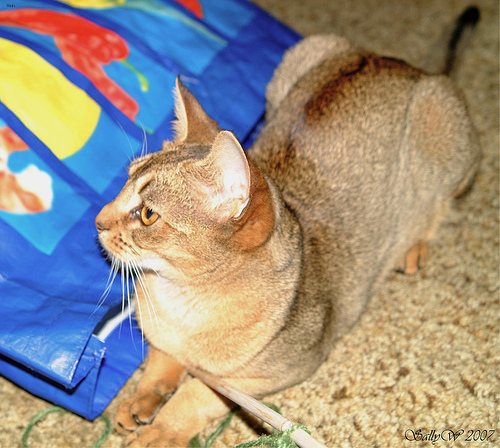

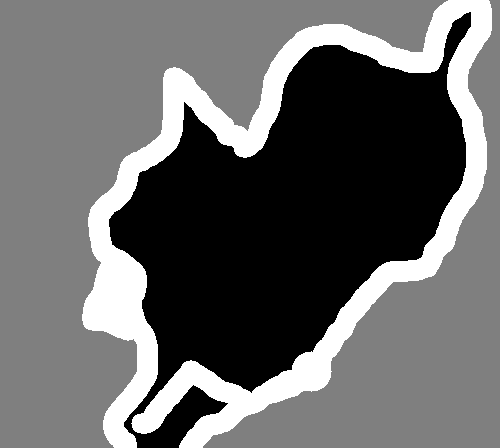

In [9]:
Show_image_mask(image_paths[9], mask_paths[9])

#**Data Generator**

In [10]:
class OxfordPets(keras.utils.Sequence):
    """Helper to iterate over the data (as Numpy arrays)."""

    def __init__(self, image_paths, mask_paths, batch_size=32, img_size=(160, 160)):
        self.batch_size = batch_size
        self.img_size = img_size
        self.image_paths = image_paths
        self.mask_paths = mask_paths

    def __len__(self):
        return len(self.mask_paths) // self.batch_size

    def __getitem__(self, idx):
        """Returns tuple (input, target) correspond to batch #idx."""
        i = idx * self.batch_size
        batch_image_paths = self.image_paths[i : i + self.batch_size]
        batch_mask_paths = self.mask_paths[i : i + self.batch_size]
        x = np.zeros((self.batch_size,) + self.img_size + (3,), dtype="float32")
        for j, path in enumerate(batch_image_paths):
            img = load_img(path, target_size=self.img_size)
            x[j] = img
        y = np.zeros((self.batch_size,) + self.img_size + (1,), dtype="uint8")
        for j, path in enumerate(batch_mask_paths):
            img = load_img(path, target_size=self.img_size, color_mode="grayscale")
            y[j] = np.expand_dims(img, 2)
            # Ground truth labels are 1, 2, 3. Subtract one to make them 0, 1, 2:
            y[j] -= 1
        return x, y

#**Model**

I used SD_UNet model for this task. I implemented this model a few month ago and in readme file I explained the architecture briefly.
You can find the paper by searching: "sd-unet: a novel segmentation framework for ct images of lung infections".

In [11]:
def conv_block(num_filters: int, input: tf.Tensor, kernel_size=3, dilation_rate=1) -> tf.Tensor:
  """
  Buld a simple block which will use many times in model architecture
  args:
    num_filters: Depth of convolution layer.
    input: Tensor.
    kernel_size: Size of kernels in convolution layer.
    dilation_rate: Rate of dilation.
    
  return:
    x: Tensor.
  """
  x = Conv2D(num_filters, kernel_size=kernel_size, strides=(1, 1), dilation_rate=dilation_rate ,padding="same", use_bias=True)(input)
  x = GroupNormalization(groups=32)(x)
  x = LeakyReLU()(x)
  return x

In [12]:
def sa_block(num_filters: int, x: tf.Tensor) -> tf.Tensor:
  """
  Build a squeez and attention (SA) block which was introduced in paper.
  args:
    num_filters: Depth of convolution layer.
    input: Tensor.
  
  return:
    x: Tensor.
  """
  x_res = conv_block(num_filters, x)
  y_res = conv_block(num_filters, x_res)
  x_atten = AveragePooling2D(pool_size=2, strides=2)(x)
  x_atten = conv_block(num_filters, x_atten)
  x_atten = conv_block(num_filters, x_atten)
  y_atten = UpSampling2D(size=(2, 2))(x_atten)
  out_1 = Multiply()([y_atten, y_res])
  out = Add()([out_1, y_atten])
  return out

In [13]:
def downsample_block(num_filters: int, x: tf.Tensor) -> tf.Tensor:
  """
  Build a down sample block. this block will be used in encoder part.
  arg:
    num_filters: Depth of convolution layer.
    input: Tensor.

  return:
    x: Tensor.
  """
  x1 = MaxPool2D(pool_size=(2, 2), strides=2)(x)
  x2 = AveragePooling2D(pool_size=(2, 2), strides=2)(x)
  x = Concatenate(axis=-1)([x1, x2])
  x = conv_block(num_filters, x, kernel_size=1)
  return x

In [14]:
def upsample_block(num_filters: int, x: tf.Tensor) -> tf.Tensor:
  """
  Build a up sample block. This block will be used in decoder part.
  args:
    num_filters: Depth of convolution block.
    input: Tensor.

  return:
    x: Tensor.
  """
  x = UpSampling2D(size=(2, 2), interpolation='bilinear')(x)
  x = conv_block(num_filters, x, kernel_size=1)
  return x

In [15]:
def daspp(input: tf.Tensor) -> tf.Tensor:
    """
    Build Dense Atrous Spatial Pyramid Pooling(DASPP) block. 
    This block will be used in the bottleneck between encoder and decoder.
    arg:
      input: Tensor.

    return:
      output: Tensor.
    """
    dims = input.shape
    x = AveragePooling2D(pool_size=(dims[-3], dims[-2]))(input)
    x = conv_block(num_filters=256, input=x, kernel_size=1)
    out_pool = UpSampling2D(
          size=(dims[-3] // x.shape[1], dims[-2] // x.shape[2]),
          interpolation="bilinear")(x)
    out_1 = conv_block(num_filters=256, input=input, kernel_size=1, dilation_rate=1)
    out_6 = conv_block(num_filters=256, input=input, kernel_size=3, dilation_rate=6)
    x_12 = Concatenate(axis=-1)([input, out_6])
    out_12 = conv_block(num_filters=256, input=x_12, kernel_size=3, dilation_rate=12)
    x_18 = Concatenate(axis=-1)([input, x_12, out_12])
    out_18 = conv_block(num_filters=256, input=x_18, kernel_size=3, dilation_rate=18)
    x = Concatenate(axis=-1)([out_pool, out_1, out_6, out_12, out_18])
    output = conv_block(num_filters=256, input=x, kernel_size=1)
    return output

In [16]:
def sd_unet(num_class: int, input_size=(160, 160, 3)) -> tf.Tensor:
    """
    Build sd_unet model.
    args: 
      num_class: Number of classes.
      input_size: Size of entery images.
    return:
      out: The model's predicted mask for input.
    """
    # Encoder
    input = keras.Input(input_size)
    x1 = sa_block(32, input)
    x2 = downsample_block(32, x1)
    x3 = sa_block(64, x2)
    x4 = downsample_block(64, x3)
    x5 = sa_block(128, x4)
    x6 = downsample_block(128, x5)
    x7 = sa_block(256, x6)
    x8 = downsample_block(256, x7)
    x9 = sa_block(512, x8)
    # Bottleneck
    x10 = daspp(x9)
    # Decoder
    x11 = upsample_block(256, x10)
    x12 = Concatenate(axis=-1)([x11, x7])
    x13 = sa_block(256, x12)
    x14 = upsample_block(128, x13)
    x15 = Concatenate(axis=-1)([x14, x5])
    x16 = sa_block(128, x15)
    x17 = upsample_block(64, x16)
    x18 = Concatenate(axis=-1)([x17, x3])
    x19 = sa_block(64, x18)
    x20 = upsample_block(32, x19)
    x21 = Concatenate(axis=-1)([x20, x1])
    x22 = sa_block(32, x21)

    if num_class == 2:
      activation = 'sigmoid'
    else:
      activation = 'softmax'
    output = Conv2D(filters=num_class, kernel_size=3, padding="same", use_bias=True, activation=activation)(x22)
    return keras.Model(inputs=input, outputs=output, name="SD_UNet")

In [17]:
model = sd_unet(num_class=3)
model.summary()

Model: "SD_UNet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 160, 160, 3  0           []                               
                                )]                                                                
                                                                                                  
 average_pooling2d (AveragePool  (None, 80, 80, 3)   0           ['input_1[0][0]']                
 ing2D)                                                                                           
                                                                                                  
 conv2d_2 (Conv2D)              (None, 80, 80, 32)   896         ['average_pooling2d[0][0]']      
                                                                                            

#**Split data**

In [18]:
# Split our img paths into a training and a validation set
def split_data(image_paths: list, mask_paths: list, val_samples=900, test_samples=100):
  """
  split the data into train, validation and test parts.
  """
  random.Random(1337).shuffle(image_paths)
  random.Random(1337).shuffle(mask_paths)
  train_image_paths = image_paths[:-val_samples-test_samples]
  train_mask_paths = mask_paths[:-val_samples-test_samples]
  val_image_paths = image_paths[-val_samples:-test_samples]
  val_mask_paths = mask_paths[-val_samples:-test_samples]
  test_image_paths = image_paths[-test_samples:]
  test_mask_paths = mask_paths[-test_samples:]
  train_gen = OxfordPets(train_image_paths, train_mask_paths)
  val_gen = OxfordPets(val_image_paths, val_mask_paths)
  test_gen = OxfordPets(test_image_paths, test_mask_paths)
  return train_gen, val_gen, test_gen, test_image_paths, test_mask_paths

In [19]:
train_gen, val_gen, test_gen, test_image_paths, test_mask_paths= split_data(image_paths, mask_paths)

#**Train the model**

In [20]:
model.compile(optimizer="rmsprop", loss="sparse_categorical_crossentropy")

callbacks = [
    keras.callbacks.ModelCheckpoint("/content/drive/MyDrive/oxford_segmentation.h5", save_best_only=True),
    EarlyStopping(
                  monitor="val_loss",
                  patience=5,
                  verbose=0,
)
]

# Train the model, doing validation at the end of each epoch.
epochs = 30
model.fit(train_gen, epochs=epochs, validation_data=val_gen, callbacks=callbacks)

Epoch 1/30
199/199 [==============================] - 258s 958ms/step - loss: 0.6583 - val_loss: 0.5318
Epoch 2/30
199/199 [==============================] - 188s 942ms/step - loss: 0.4915 - val_loss: 0.4421
Epoch 3/30
199/199 [==============================] - 187s 939ms/step - loss: 0.4271 - val_loss: 0.3792
Epoch 4/30
199/199 [==============================] - 187s 938ms/step - loss: 0.3884 - val_loss: 0.3549
Epoch 5/30
199/199 [==============================] - 188s 946ms/step - loss: 0.3610 - val_loss: 0.3767
Epoch 6/30
199/199 [==============================] - 187s 937ms/step - loss: 0.3373 - val_loss: 0.3416
Epoch 7/30
199/199 [==============================] - 185s 929ms/step - loss: 0.3202 - val_loss: 0.4148
Epoch 8/30
199/199 [==============================] - 187s 938ms/step - loss: 0.3112 - val_loss: 0.2974
Epoch 9/30
199/199 [==============================] - 185s 927ms/step - loss: 0.2953 - val_loss: 0.3052
Epoch 10/30
199/199 [==============================] - 186s 937m

In [13]:
model = keras.models.load_model("/content/drive/MyDrive/oxford_segmentation.h5")

# **Split convolution layers**

In [21]:
def get_conv_layers(model: tf.keras.Model):
  """
  This function get model as input and return a list of convolution layers indexes.
  args:
    model: Tensorflow model.
  return:
    layer_number: number of convolution layers.
    filters, biases: weights of convolution layers filters.
  """
  i = 0
  layer_number = []
  for layer in model.layers:
    i += 1
  # check for convolutional layer
    if 'conv' not in layer.name:
      continue
  # get filter weights
    filter, bias = layer.get_weights()
    layer_number.append(i)
    print(f'number of conv in order of layers is: {i+1}\n', layer.name, filter.shape, bias.shape)
  return layer_number

In [22]:
layer_number = get_conv_layers(model)

number of conv in order of layers is: 4
 conv2d_2 (3, 3, 3, 32) (32,)
number of conv in order of layers is: 6
 conv2d (3, 3, 3, 32) (32,)
number of conv in order of layers is: 9
 conv2d_3 (3, 3, 32, 32) (32,)
number of conv in order of layers is: 12
 conv2d_1 (3, 3, 32, 32) (32,)
number of conv in order of layers is: 22
 conv2d_4 (1, 1, 64, 32) (32,)
number of conv in order of layers is: 26
 conv2d_7 (3, 3, 32, 64) (64,)
number of conv in order of layers is: 28
 conv2d_5 (3, 3, 32, 64) (64,)
number of conv in order of layers is: 31
 conv2d_8 (3, 3, 64, 64) (64,)
number of conv in order of layers is: 34
 conv2d_6 (3, 3, 64, 64) (64,)
number of conv in order of layers is: 44
 conv2d_9 (1, 1, 128, 64) (64,)
number of conv in order of layers is: 48
 conv2d_12 (3, 3, 64, 128) (128,)
number of conv in order of layers is: 50
 conv2d_10 (3, 3, 64, 128) (128,)
number of conv in order of layers is: 53
 conv2d_13 (3, 3, 128, 128) (128,)
number of conv in order of layers is: 56
 conv2d_11 (3, 3, 1

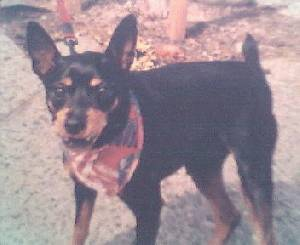

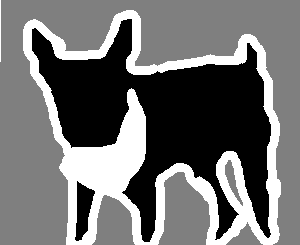

In [23]:
# Display image and mask number 0 of test data
Show_image_mask(test_image_paths[0], test_mask_paths[0])

#**Visualize feature maps convolution layers**

In [24]:
# redefine model to output right after the first convolution layer
model_layer_1 = Model(inputs=model.inputs, outputs=model.layers[layer_number[0]].output)

In [25]:
# Use first image of test data as input to visualize the feature maps
img = test_gen[0][0][0]
# Convert 3d array to 4d array
img = np.expand_dims(img, axis=0)

In [26]:
# Get new model feature maps while giving img as input
feature_maps = model_layer_1.predict(img)

1/1 [==============================] - 0s 133ms/step


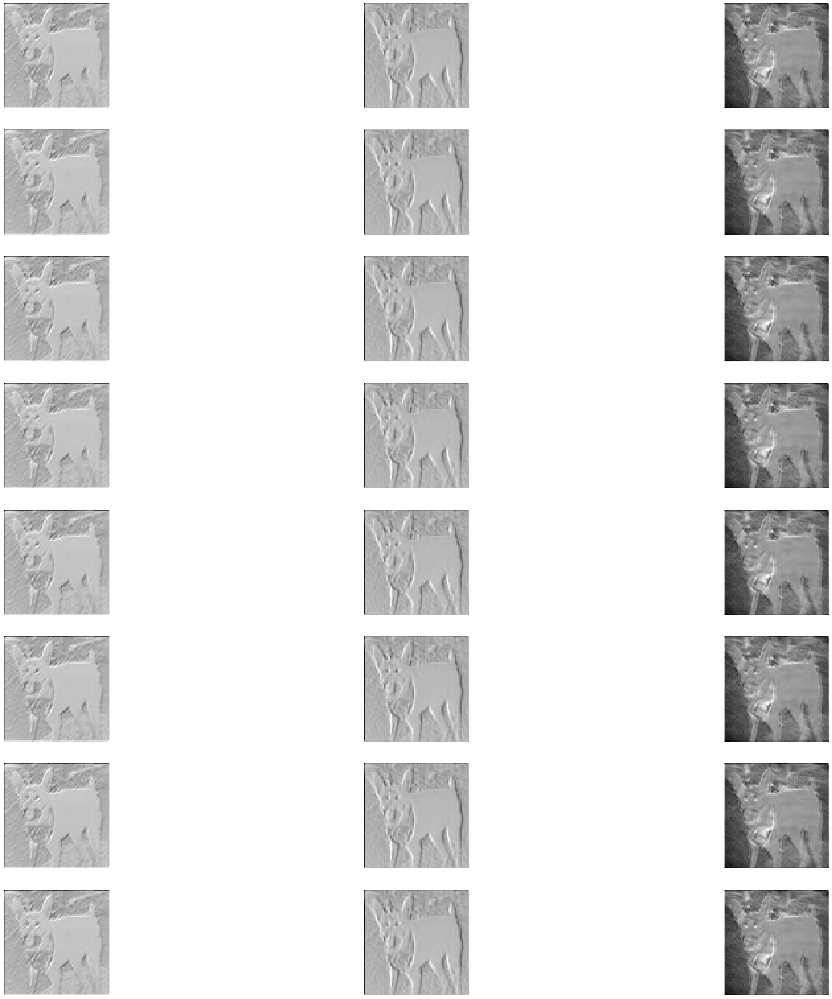

In [27]:
# First convolution layer has 32 filters and each fiter has 3 channles so 
# we plot only 8 filters or 24 images
n_fliters = 8
ix = 1
plt.figure(figsize=(50, 50), dpi=200)
for i in range(n_fliters):
    for h in range(3):
        # specify subplot and turn of axis
        ax = plt.subplot(n_fliters, 3, ix)
        ax.set_xticks([])
        ax.set_yticks([])
        # plot filter channel in grayscale
        plt.imshow(feature_maps[0, :, :, h], cmap='gray')
        ix += 1
# show the figure
plt.show()  

In [28]:
outputs = [model.layers[i-1].output for i in layer_number]
# redefine model to output right after the all convolution layers
model_all_convs = Model(inputs=model.inputs, outputs=outputs)

In [29]:
feature_maps = model_all_convs.predict(img)

1/1 [==============================] - 5s 5s/step


In [47]:
for fmap in feature_maps:
  print(fmap.shape)

(1, 80, 80, 32)
(1, 160, 160, 32)
(1, 80, 80, 32)
(1, 160, 160, 32)
(1, 80, 80, 32)
(1, 40, 40, 64)
(1, 80, 80, 64)
(1, 40, 40, 64)
(1, 80, 80, 64)
(1, 40, 40, 64)
(1, 20, 20, 128)
(1, 40, 40, 128)
(1, 20, 20, 128)
(1, 40, 40, 128)
(1, 20, 20, 128)
(1, 10, 10, 256)
(1, 20, 20, 256)
(1, 10, 10, 256)
(1, 20, 20, 256)
(1, 10, 10, 256)
(1, 5, 5, 512)
(1, 10, 10, 512)
(1, 5, 5, 512)
(1, 10, 10, 512)
(1, 10, 10, 256)
(1, 10, 10, 256)
(1, 1, 1, 256)
(1, 10, 10, 256)
(1, 10, 10, 256)
(1, 10, 10, 256)
(1, 20, 20, 256)
(1, 10, 10, 256)
(1, 20, 20, 256)
(1, 10, 10, 256)
(1, 20, 20, 256)
(1, 40, 40, 128)
(1, 20, 20, 128)
(1, 40, 40, 128)
(1, 20, 20, 128)
(1, 40, 40, 128)
(1, 80, 80, 64)
(1, 40, 40, 64)
(1, 80, 80, 64)
(1, 40, 40, 64)
(1, 80, 80, 64)
(1, 160, 160, 32)
(1, 80, 80, 32)
(1, 160, 160, 32)
(1, 80, 80, 32)
(1, 160, 160, 32)
(1, 160, 160, 3)


feature maps of conv layer number 1


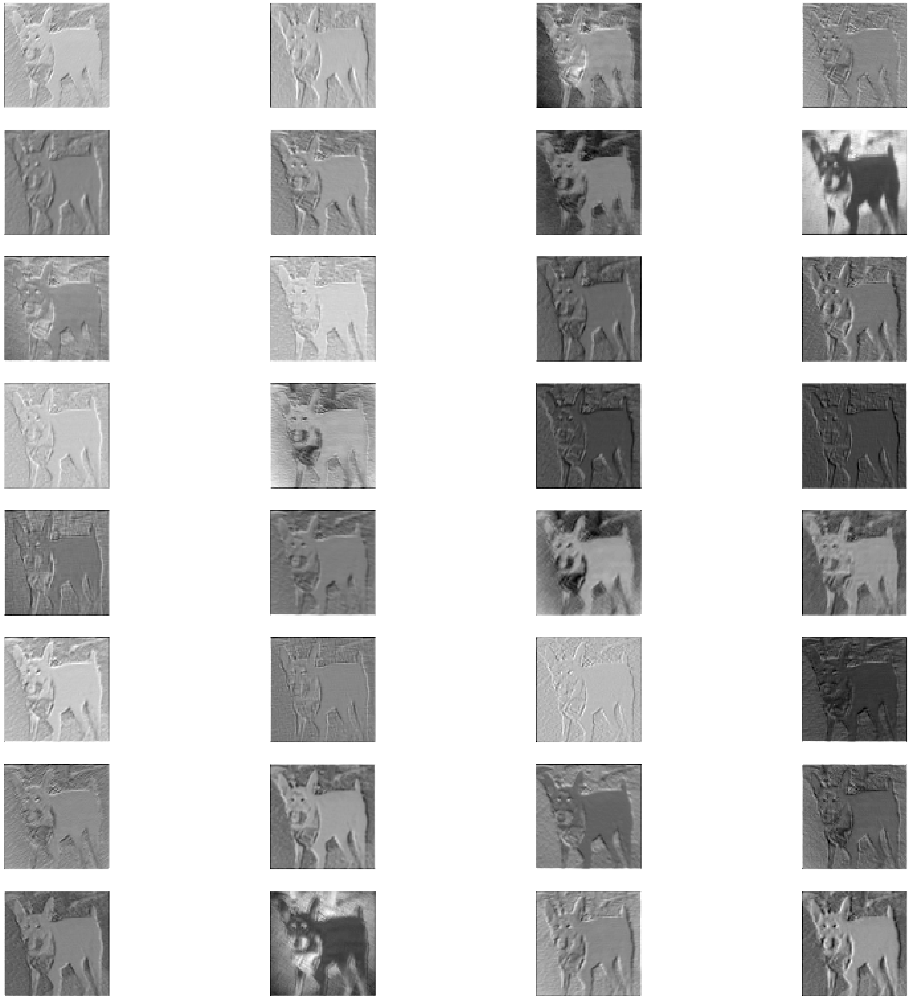

feature maps of conv layer number 2


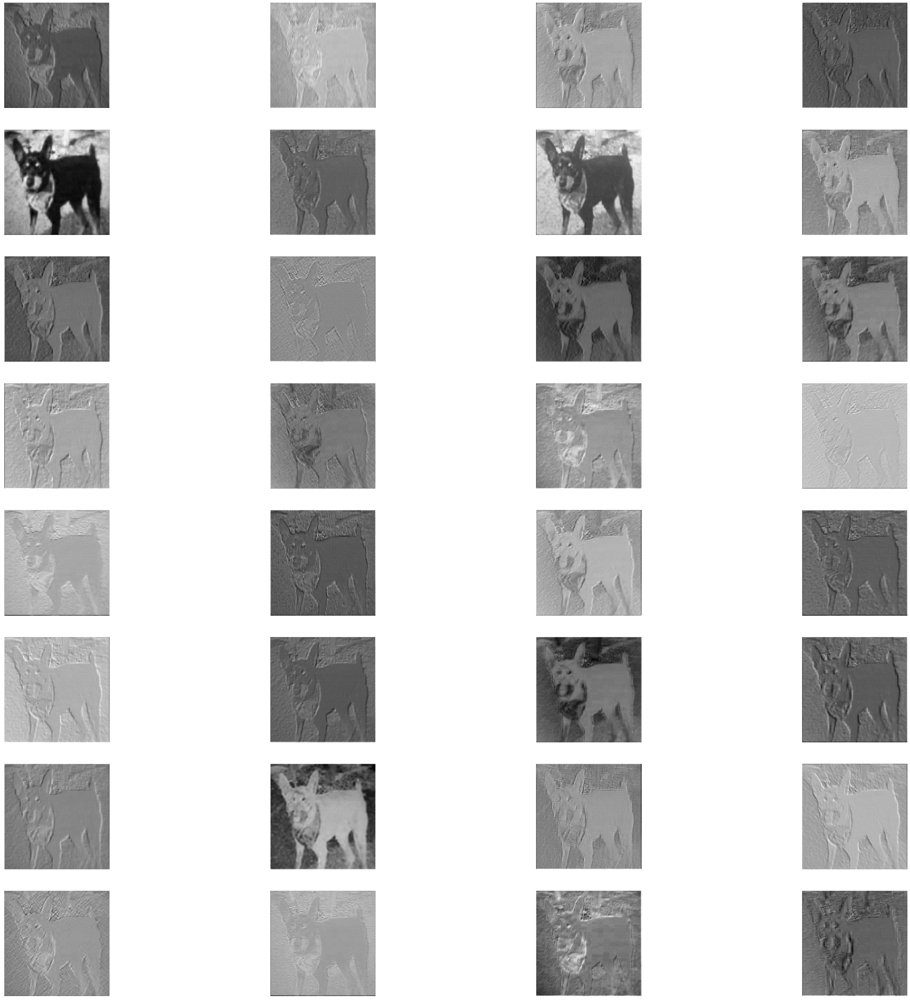

feature maps of conv layer number 3


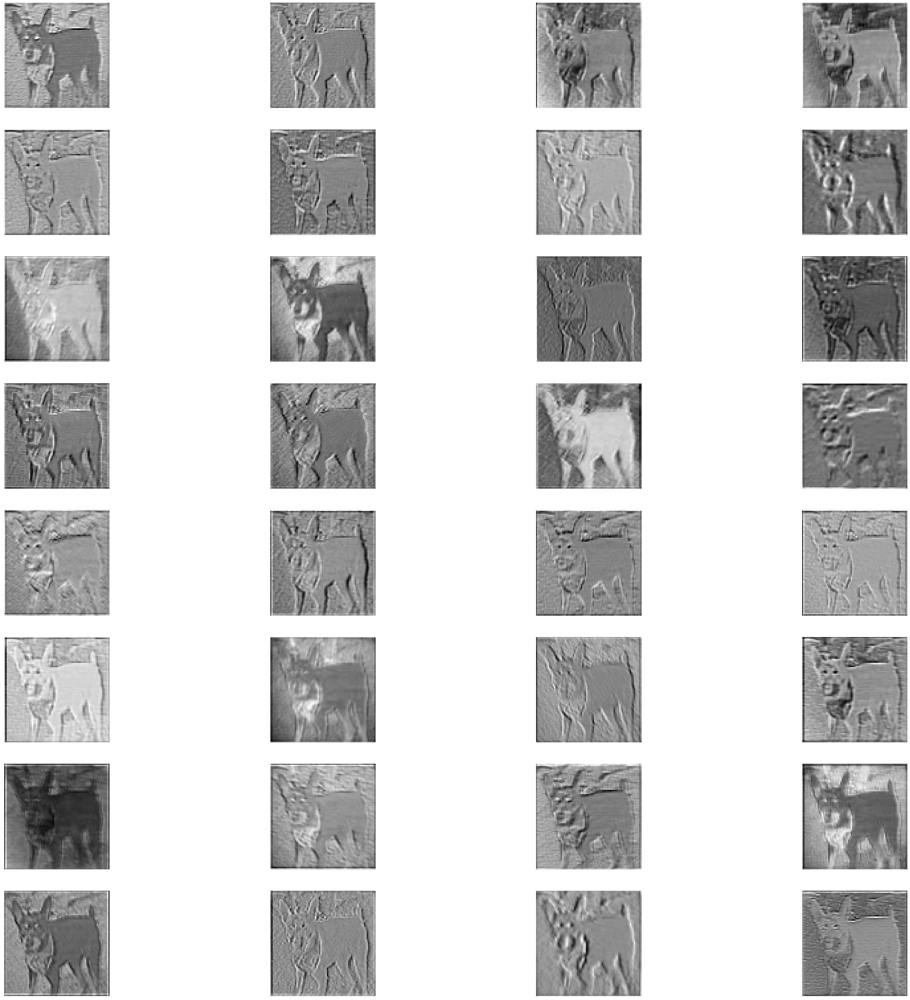

feature maps of conv layer number 4


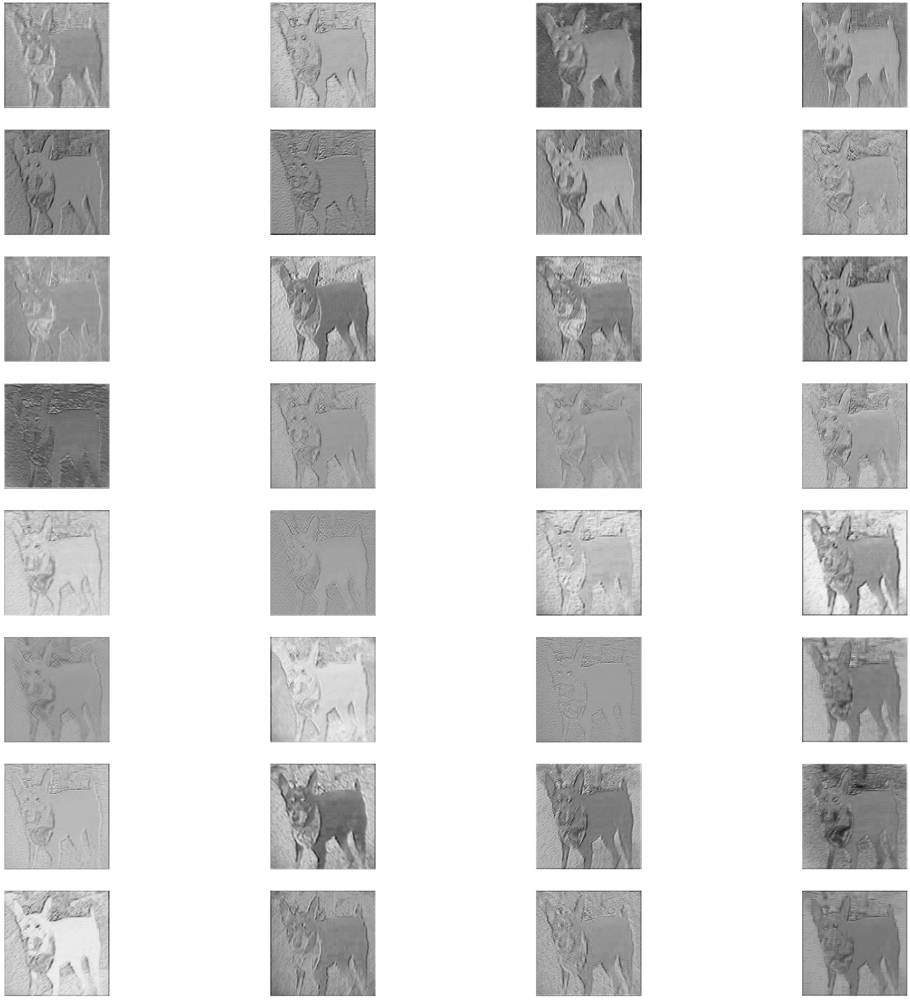

feature maps of conv layer number 5


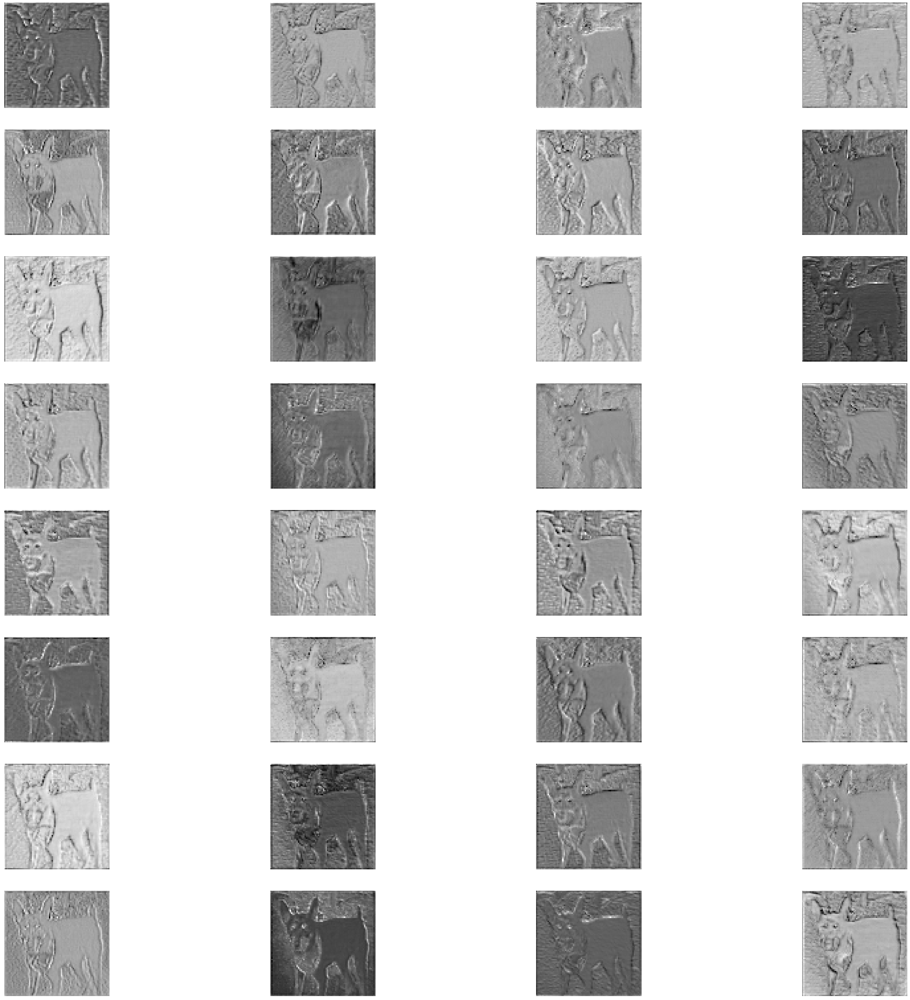

feature maps of conv layer number 6


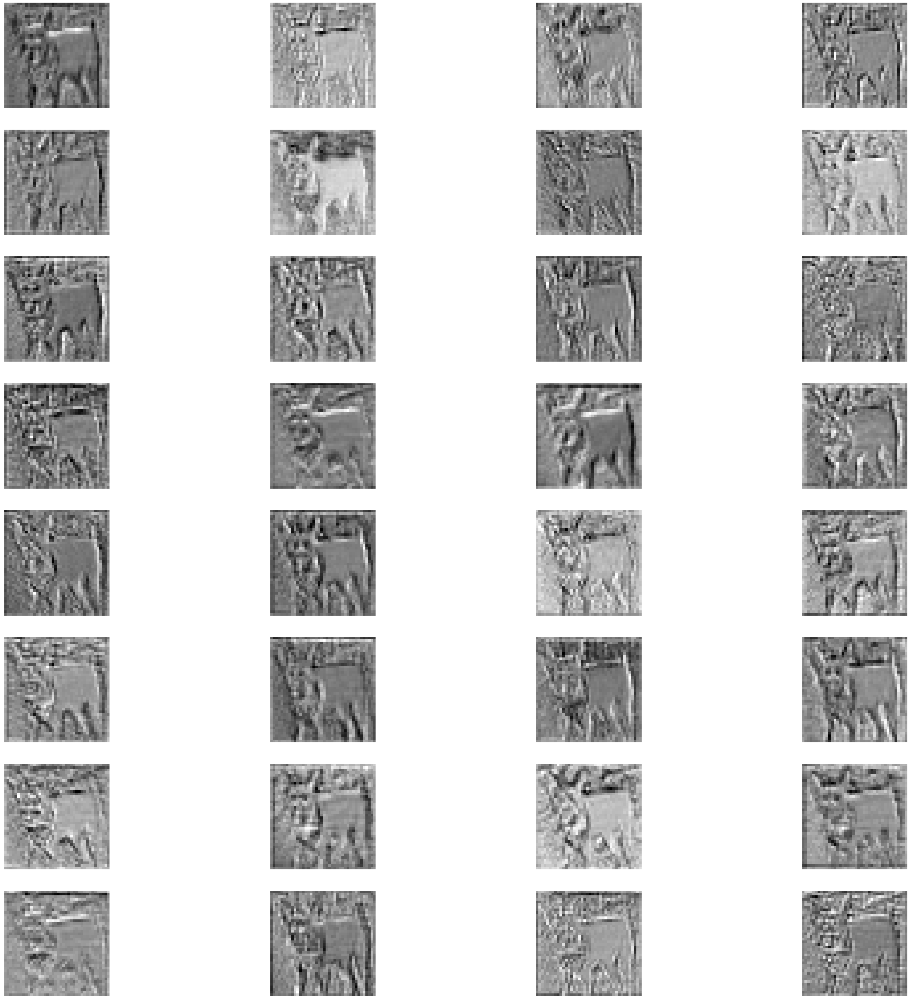

feature maps of conv layer number 7


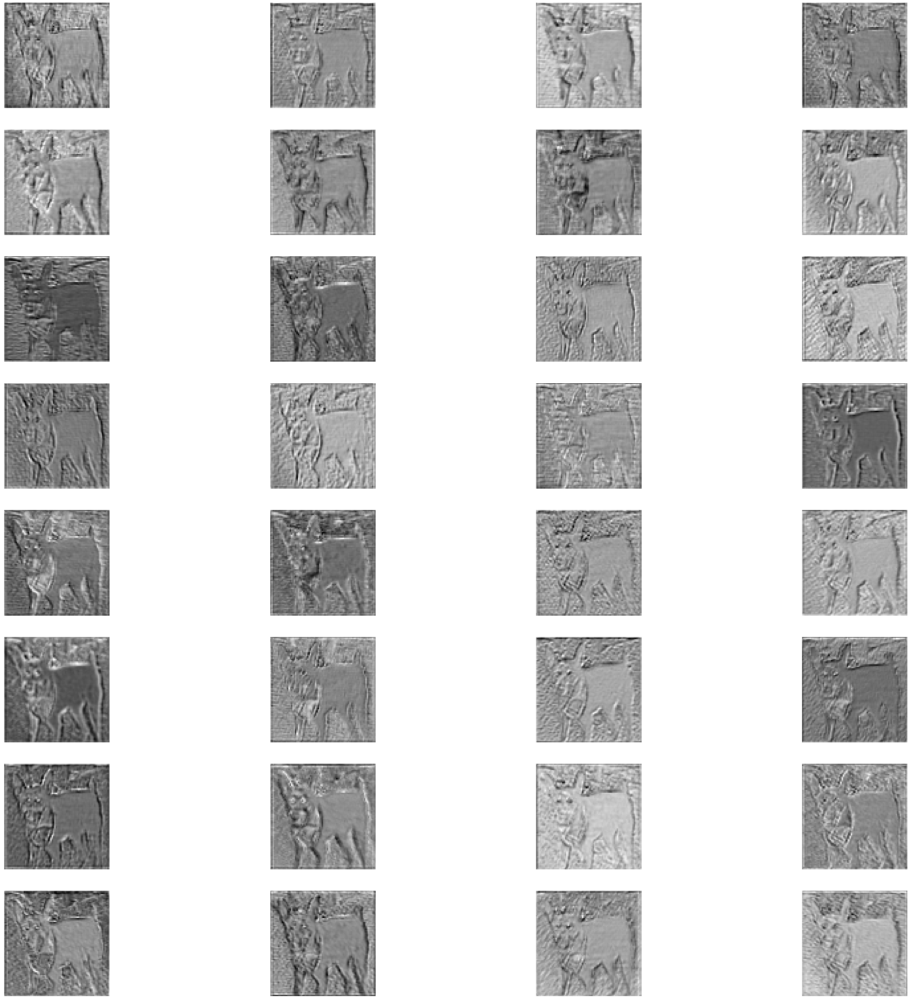

feature maps of conv layer number 8


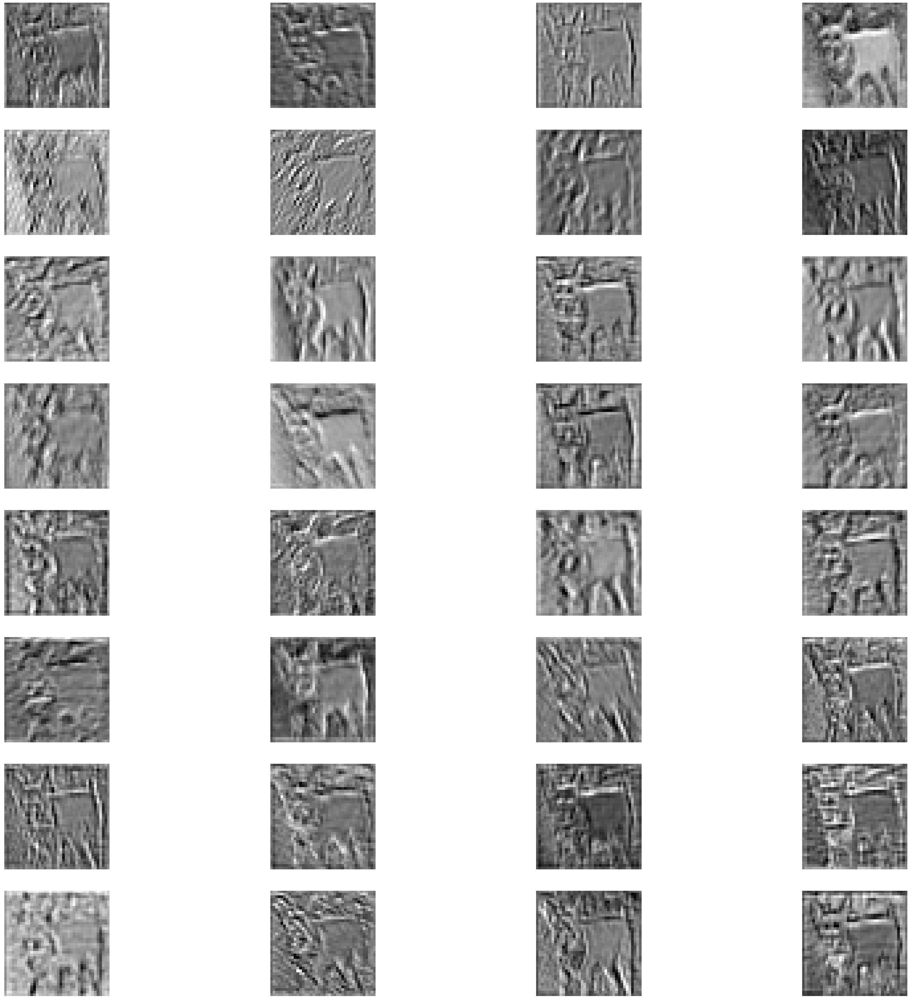

feature maps of conv layer number 9


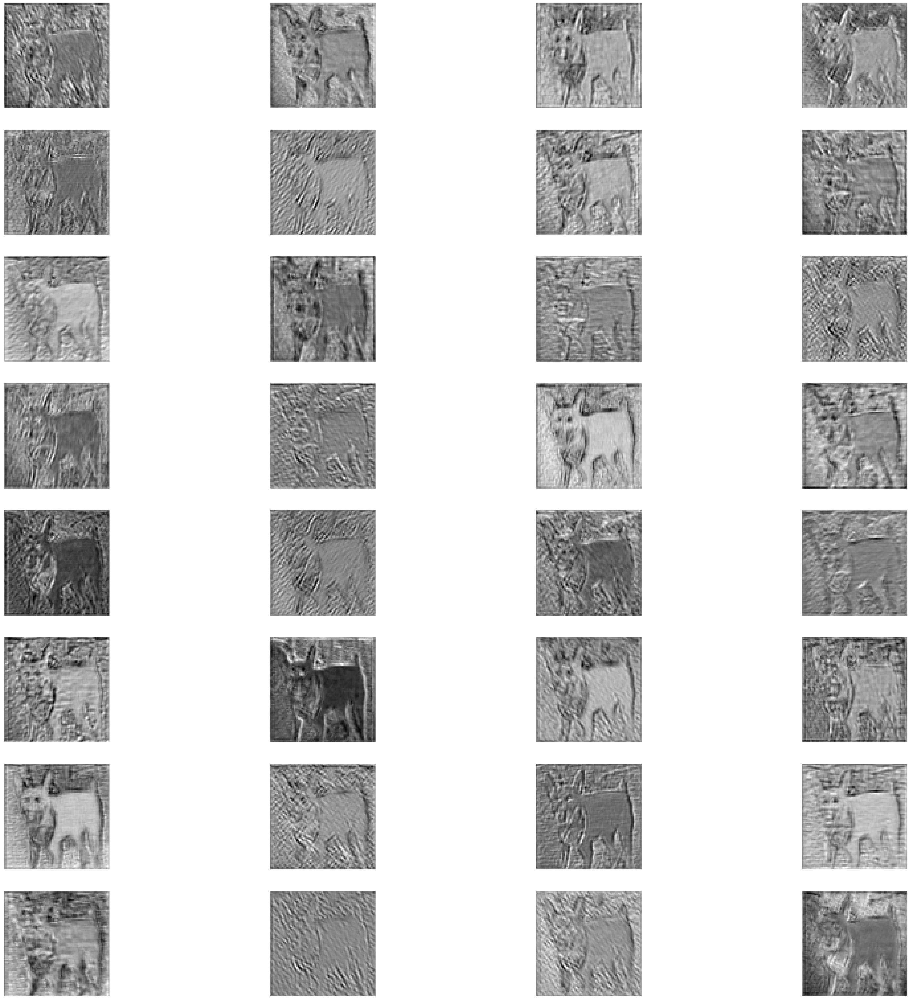

feature maps of conv layer number 10


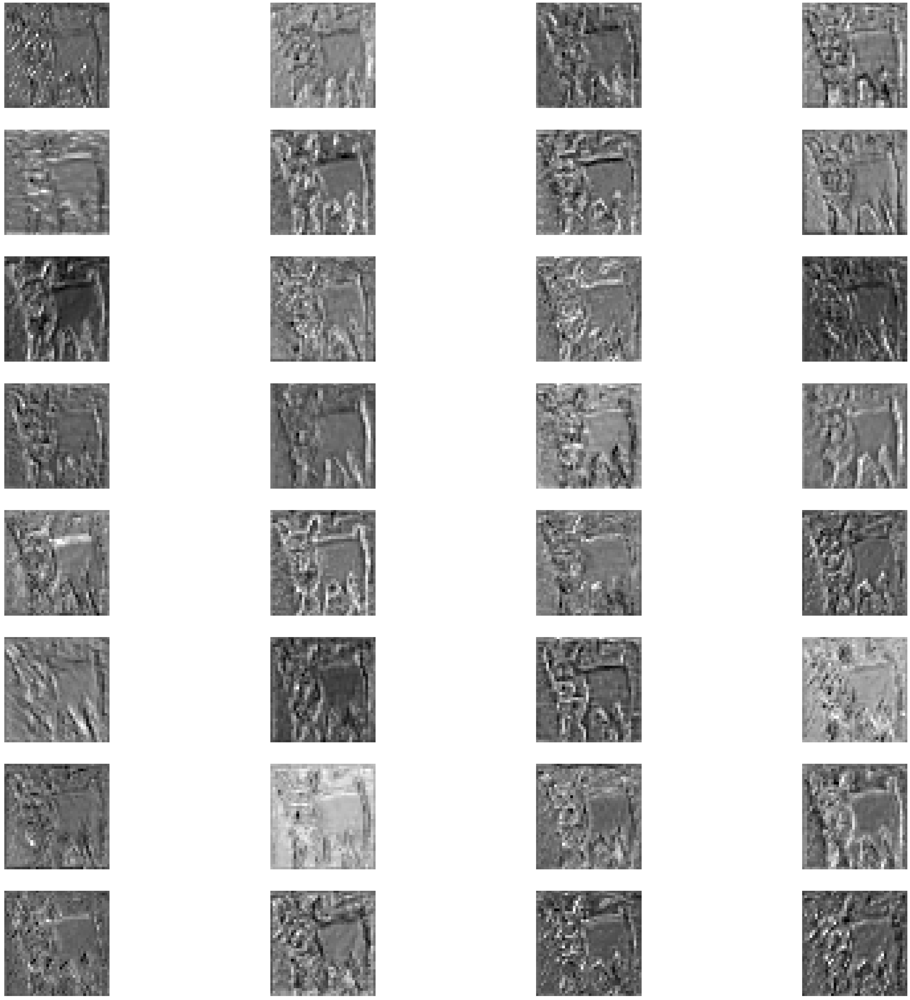

feature maps of conv layer number 11


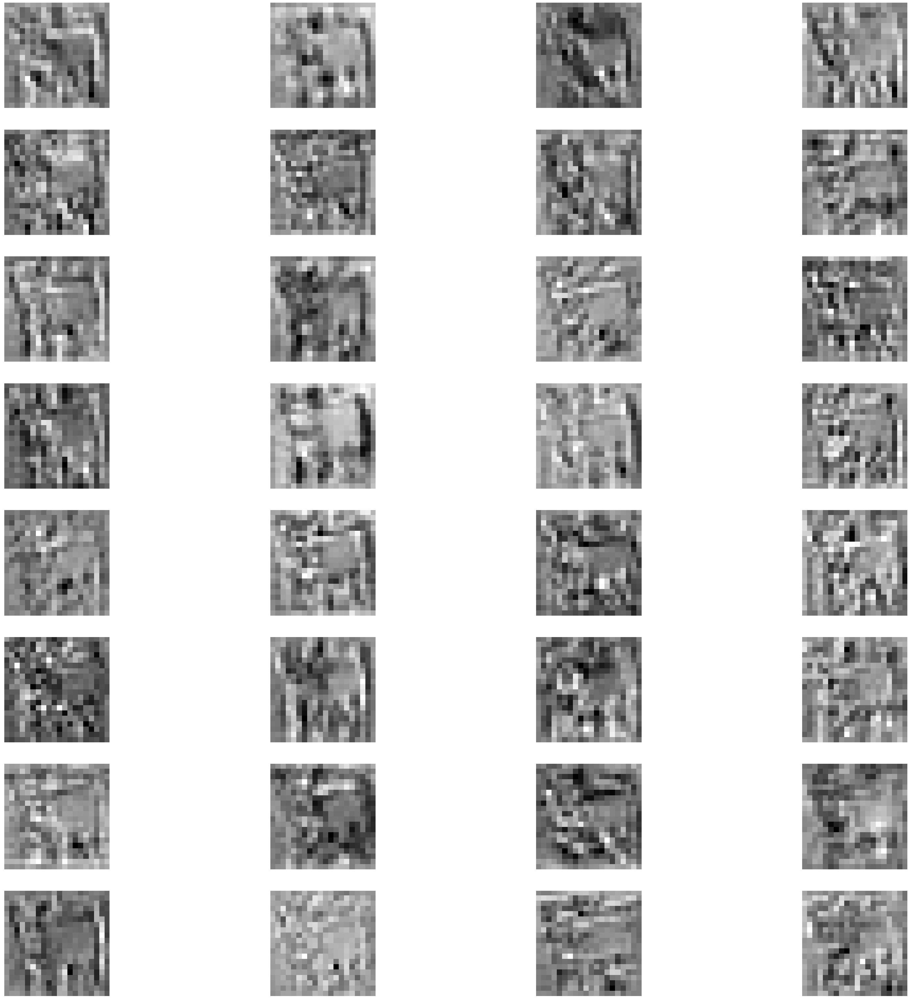

feature maps of conv layer number 12


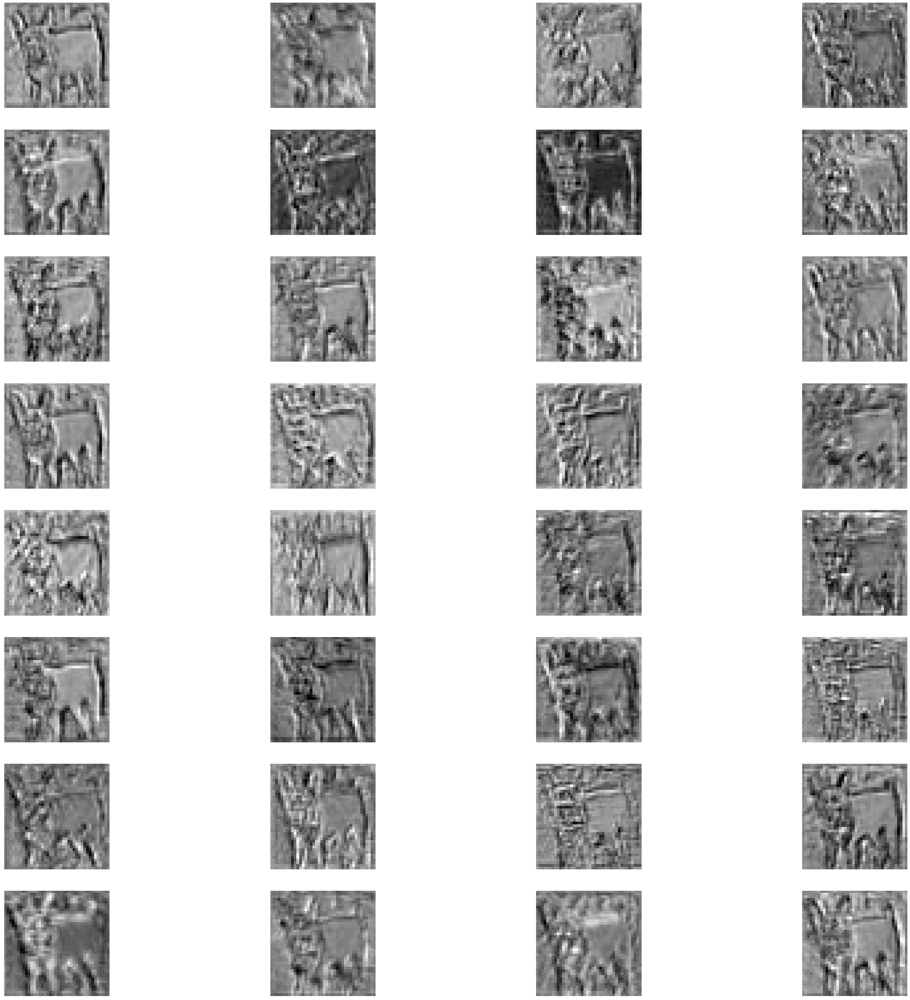

feature maps of conv layer number 13


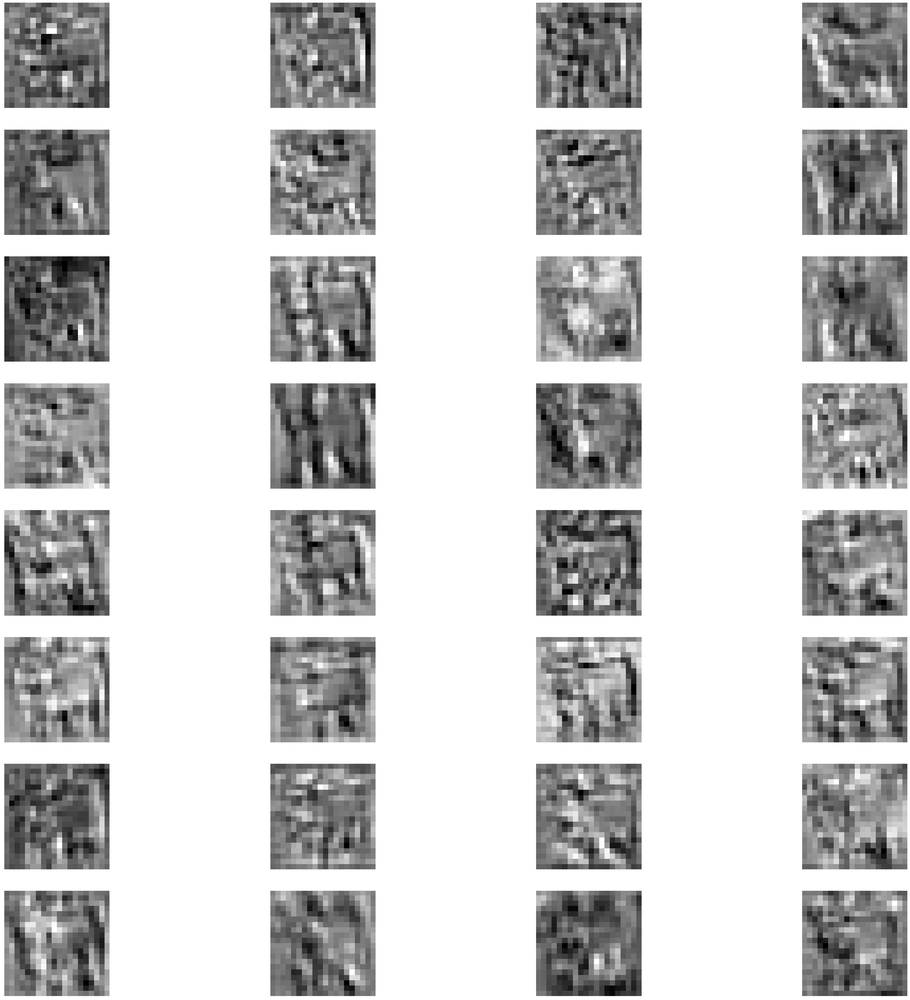

feature maps of conv layer number 14


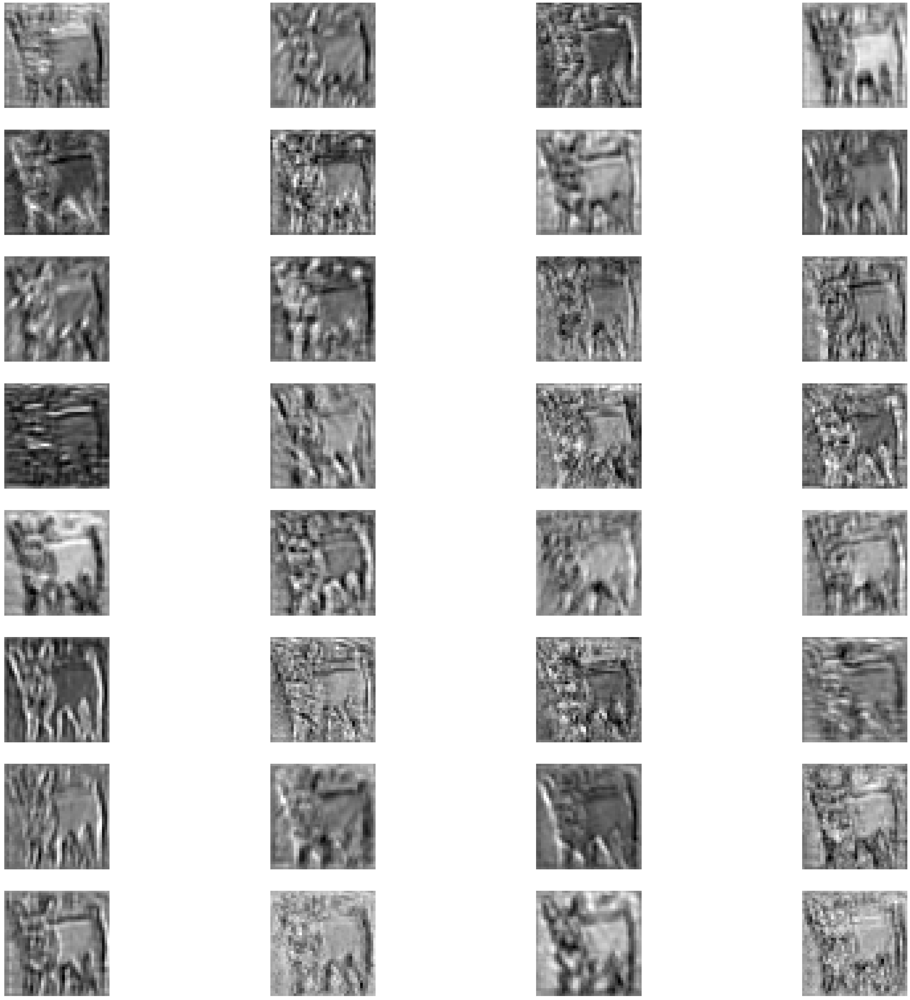

feature maps of conv layer number 15


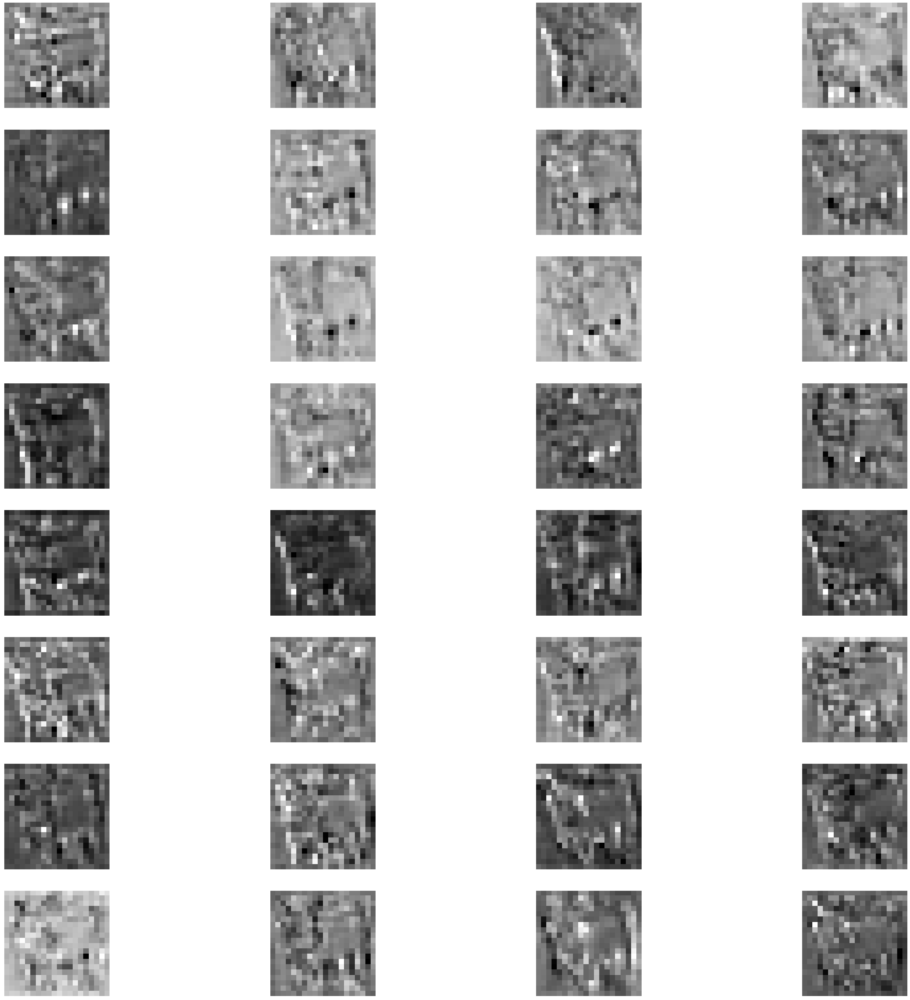

feature maps of conv layer number 16


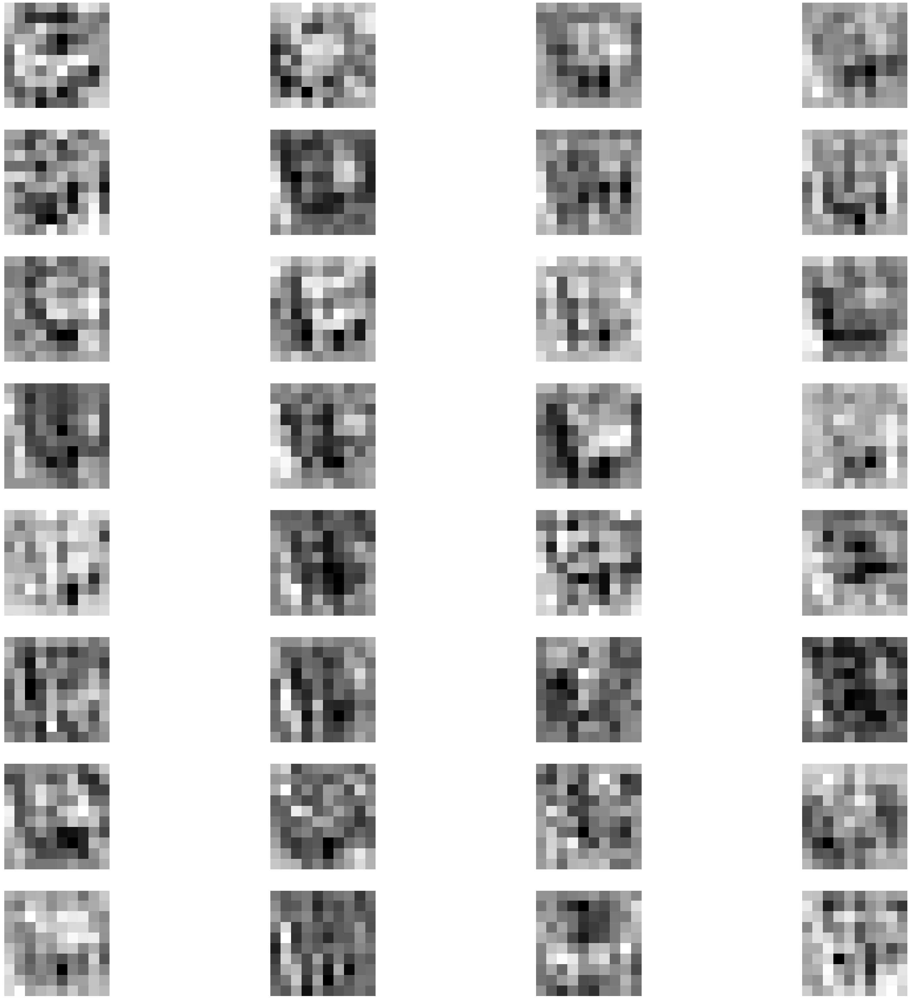

feature maps of conv layer number 17


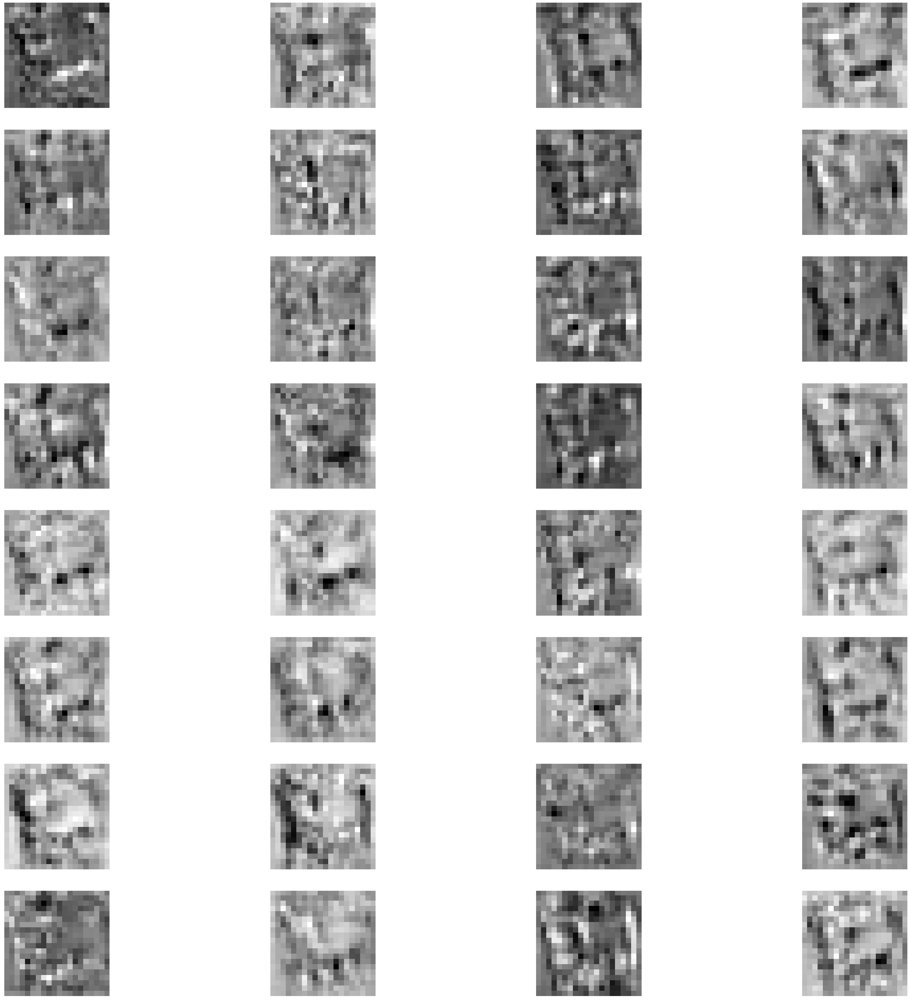

feature maps of conv layer number 18


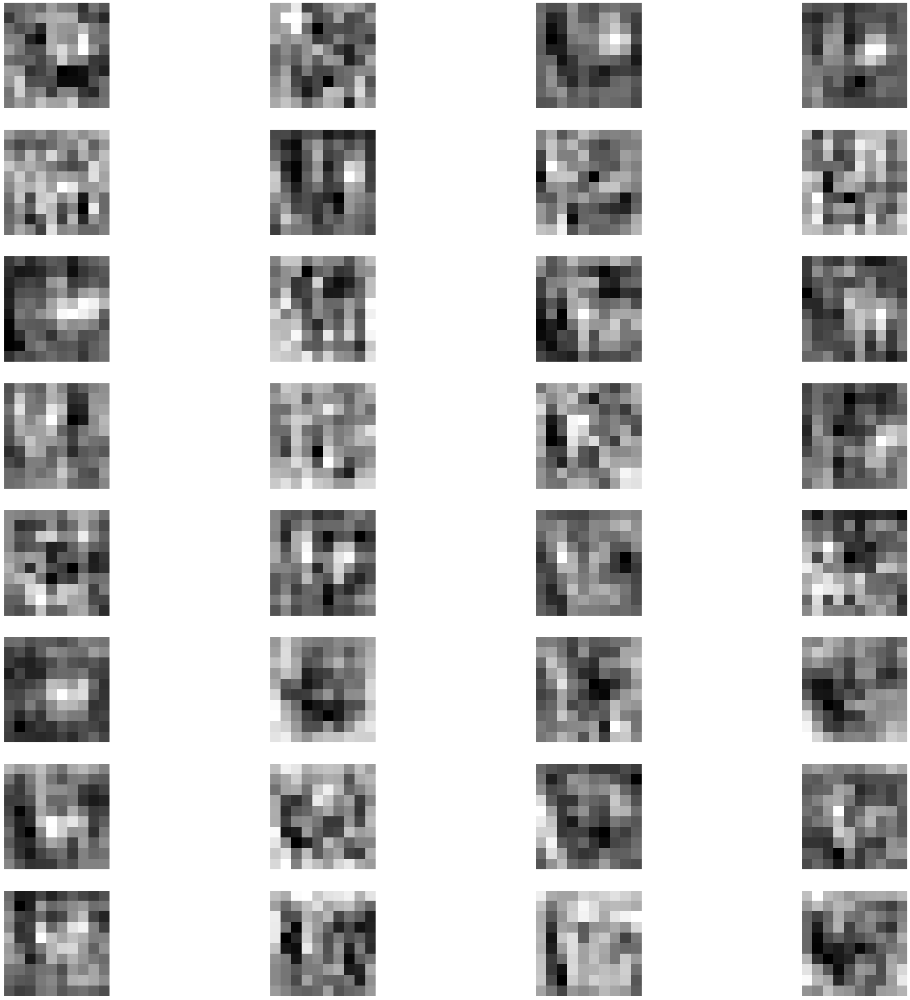

feature maps of conv layer number 19


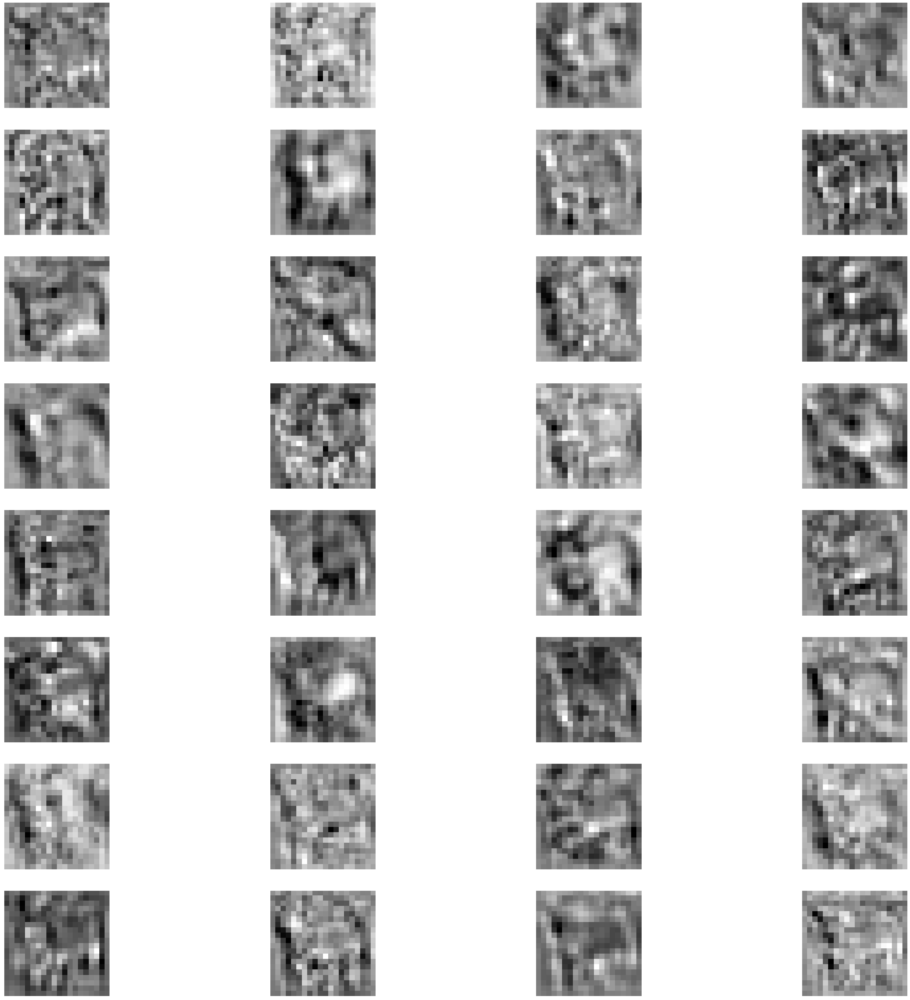

feature maps of conv layer number 20


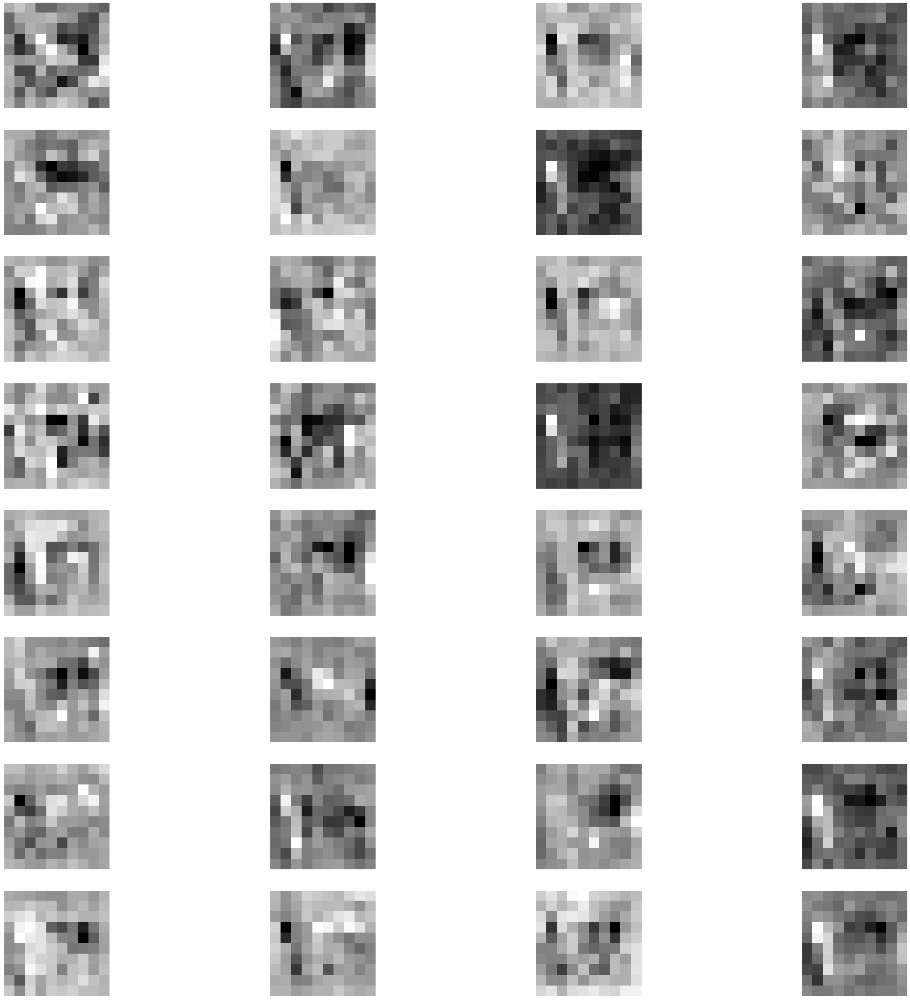

feature maps of conv layer number 21


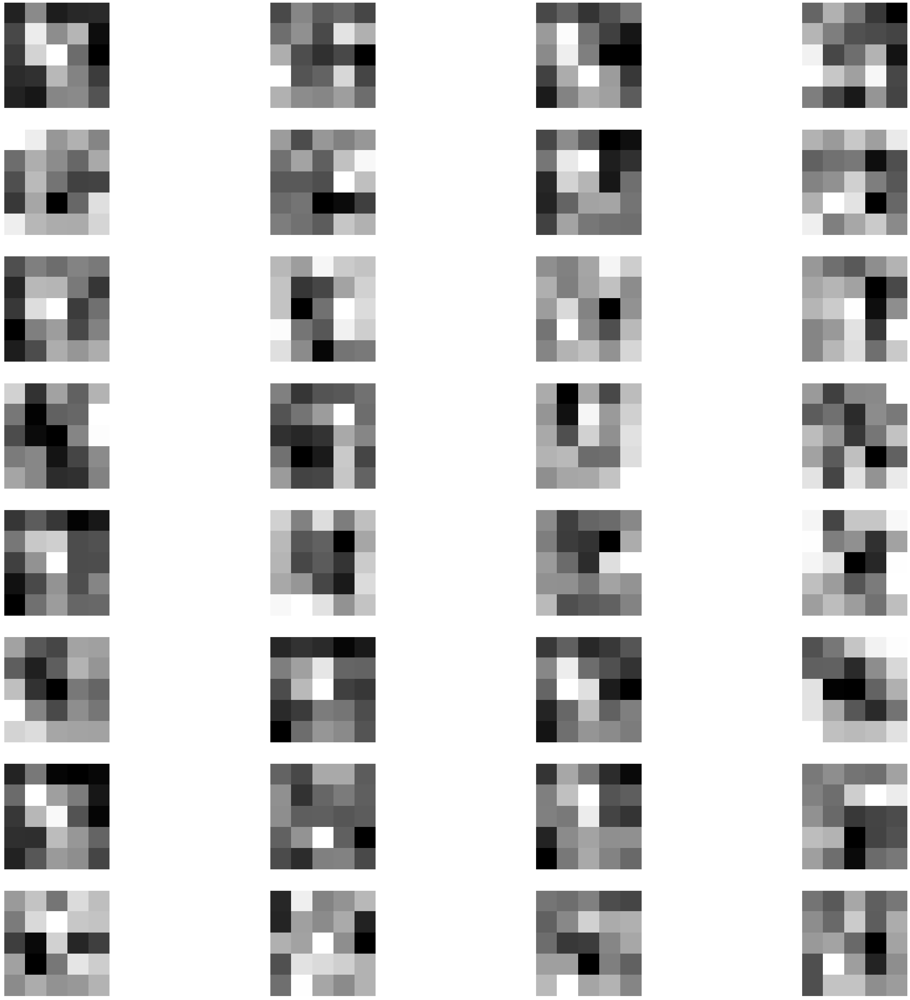

feature maps of conv layer number 22


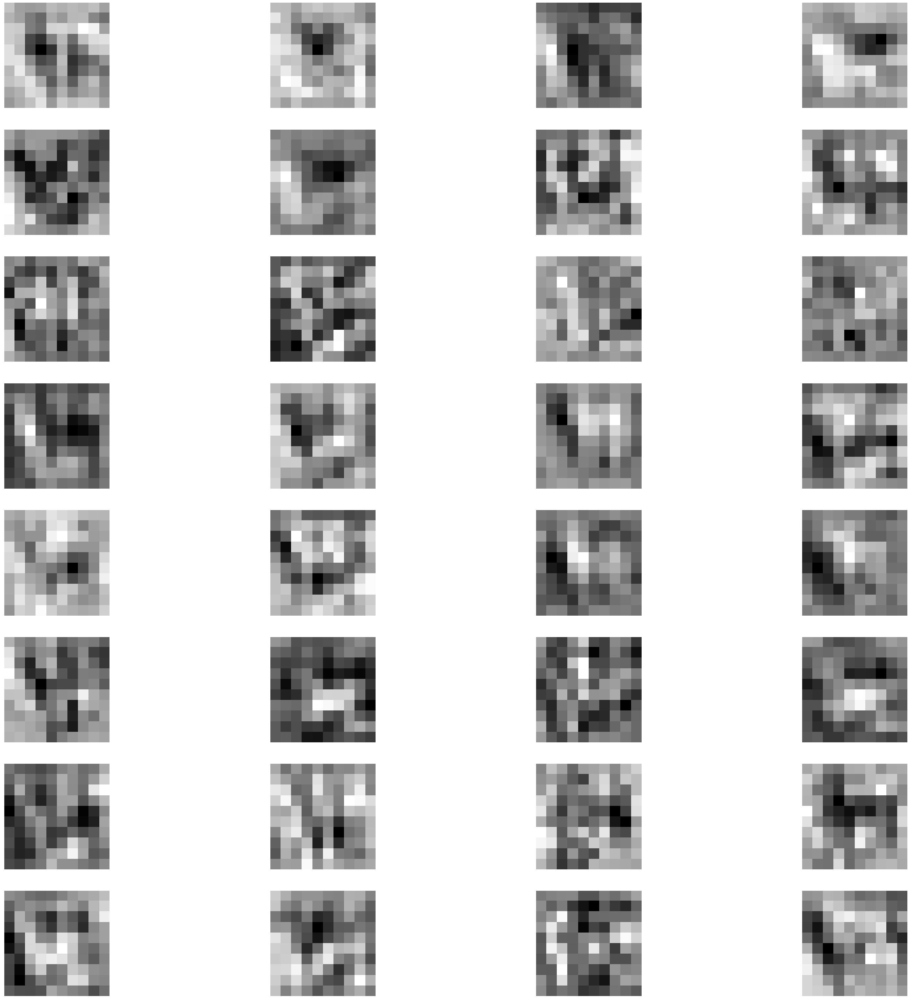

feature maps of conv layer number 23


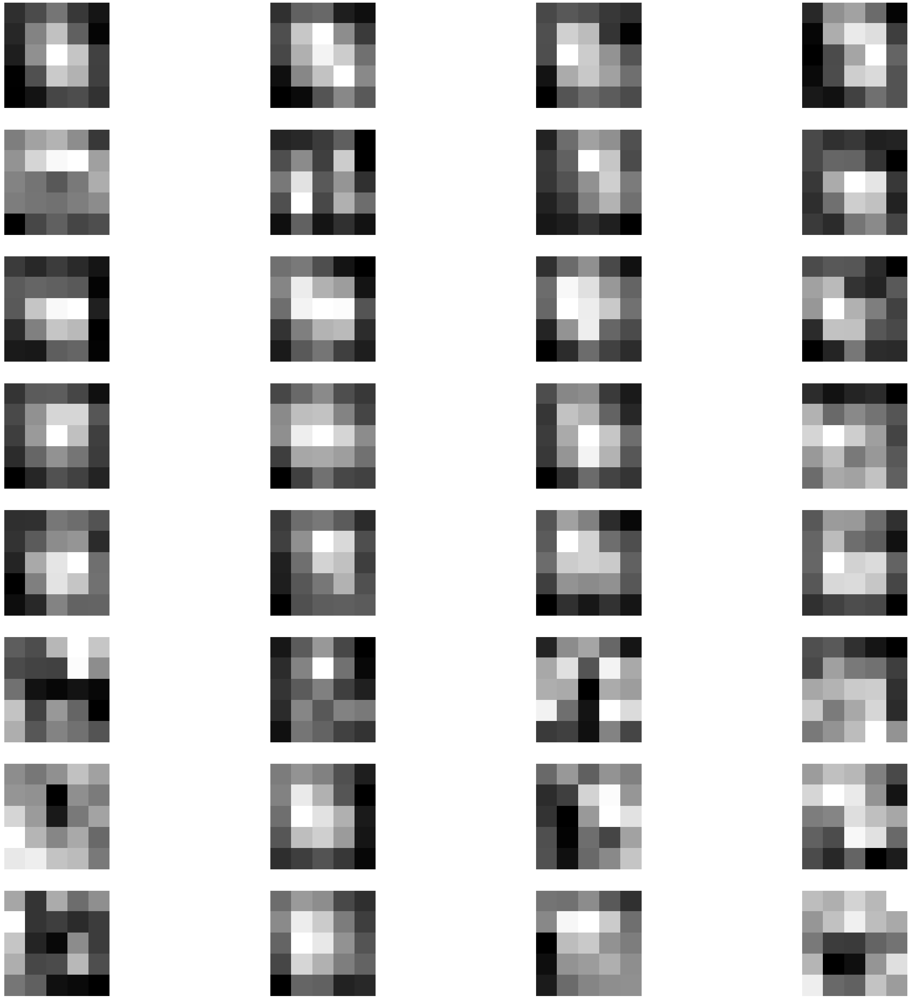

feature maps of conv layer number 24


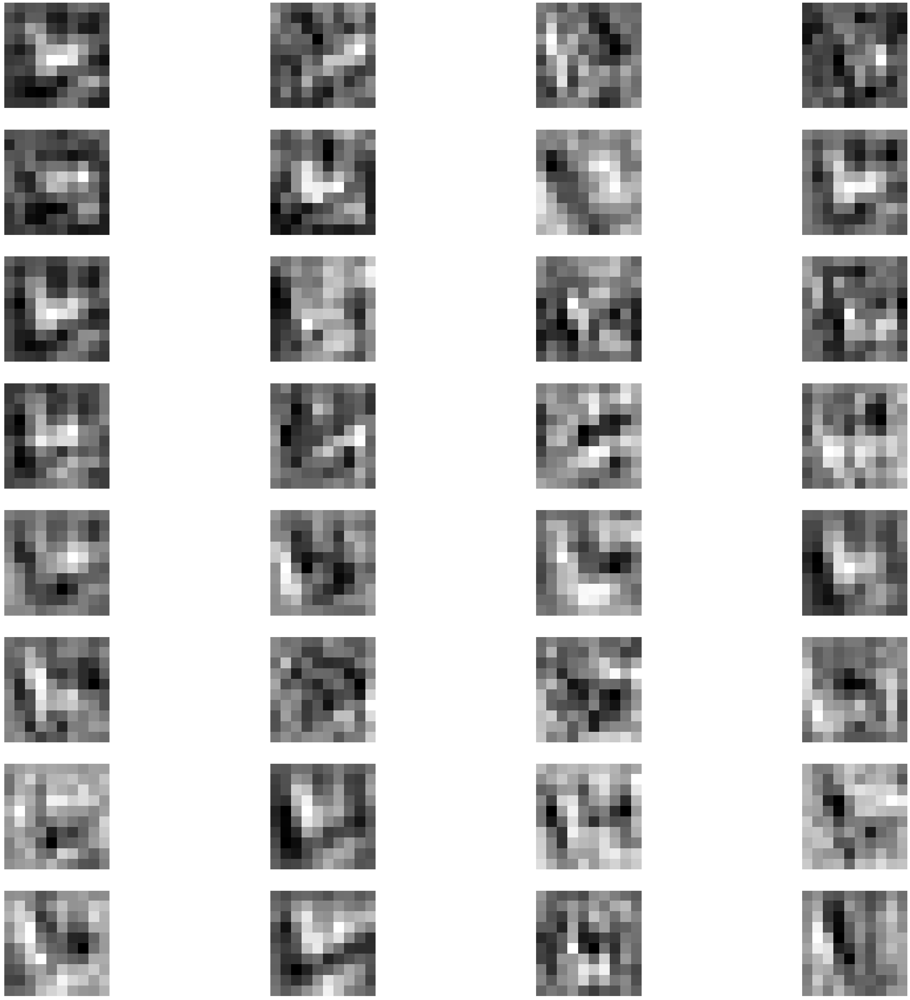

feature maps of conv layer number 25


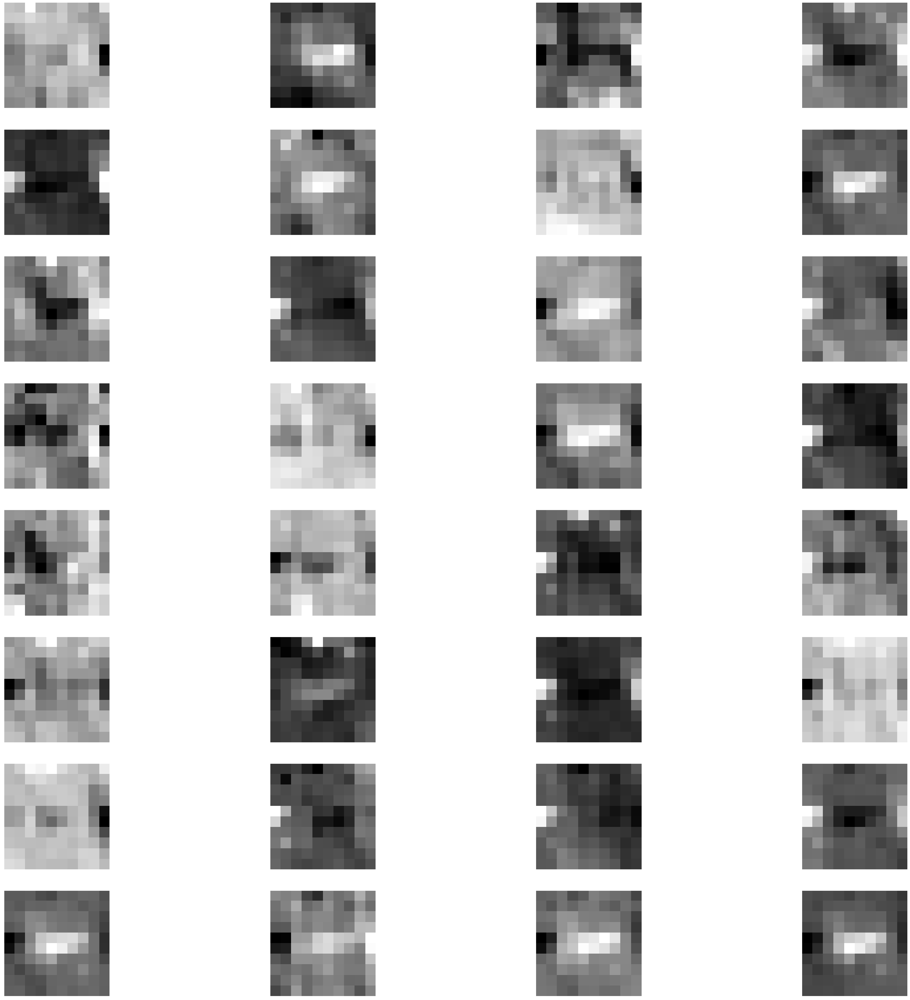

feature maps of conv layer number 26


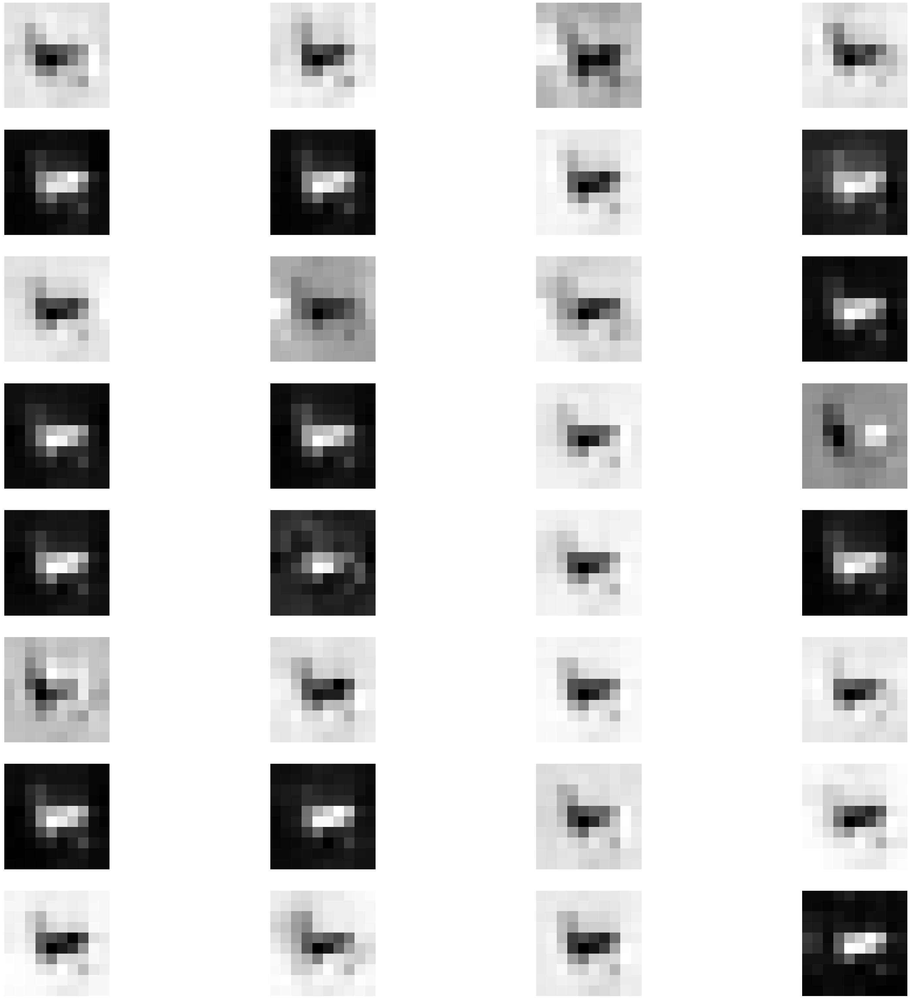

feature maps of conv layer number 27


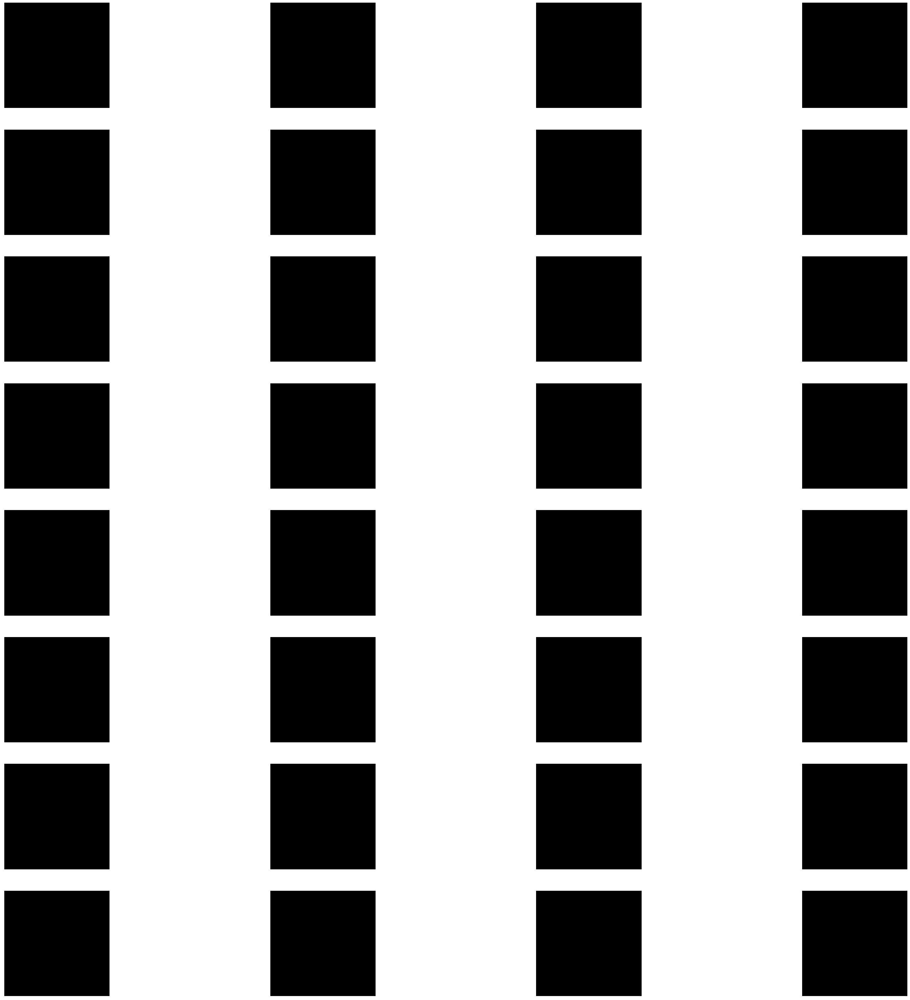

feature maps of conv layer number 28


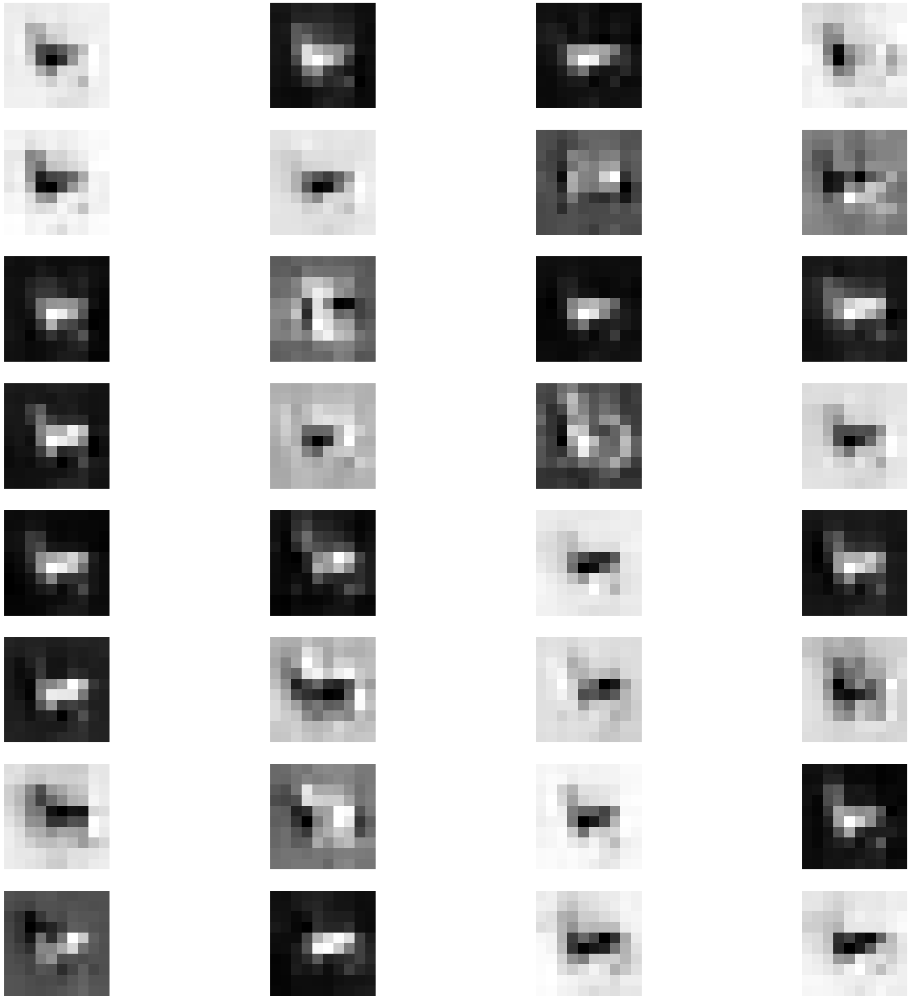

feature maps of conv layer number 29


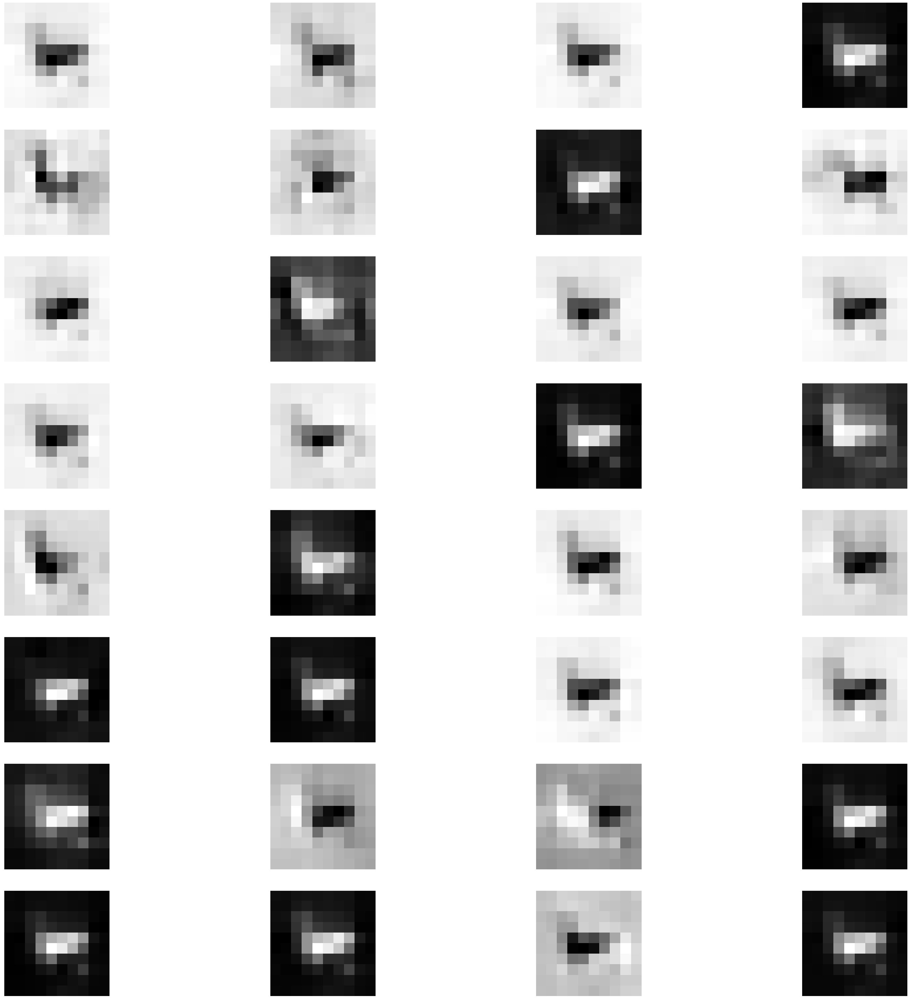

feature maps of conv layer number 30


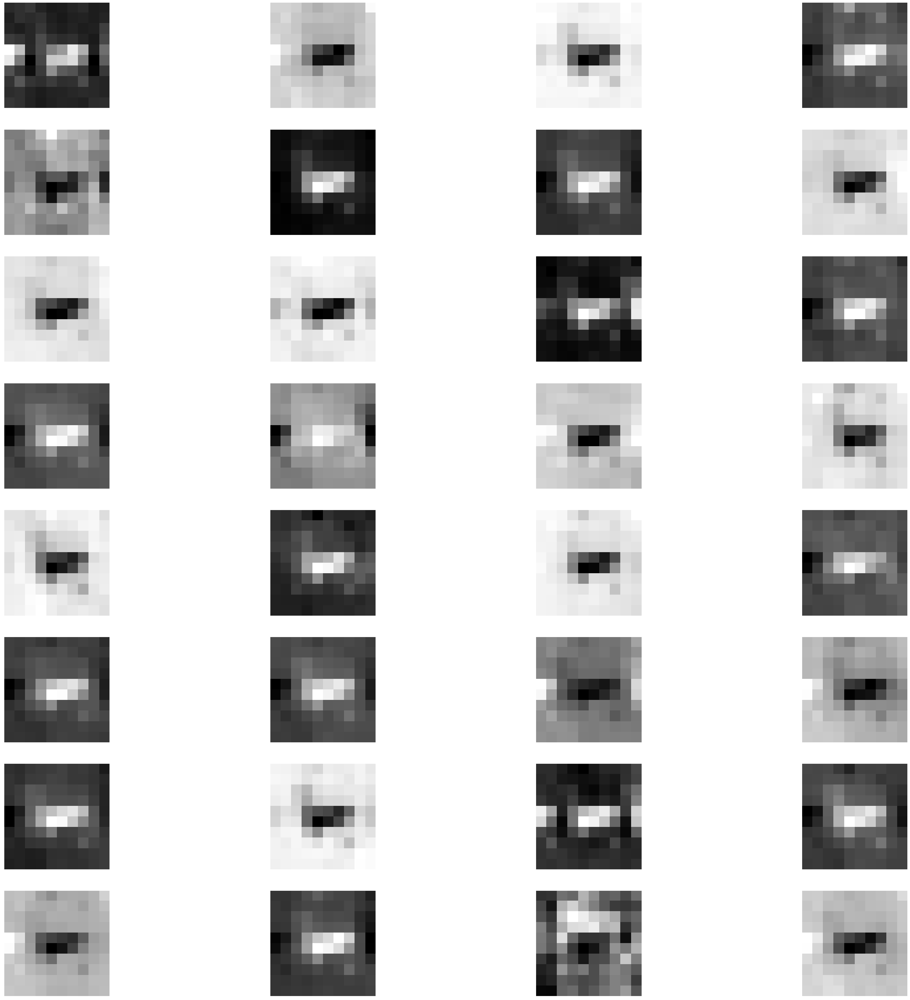

feature maps of conv layer number 31


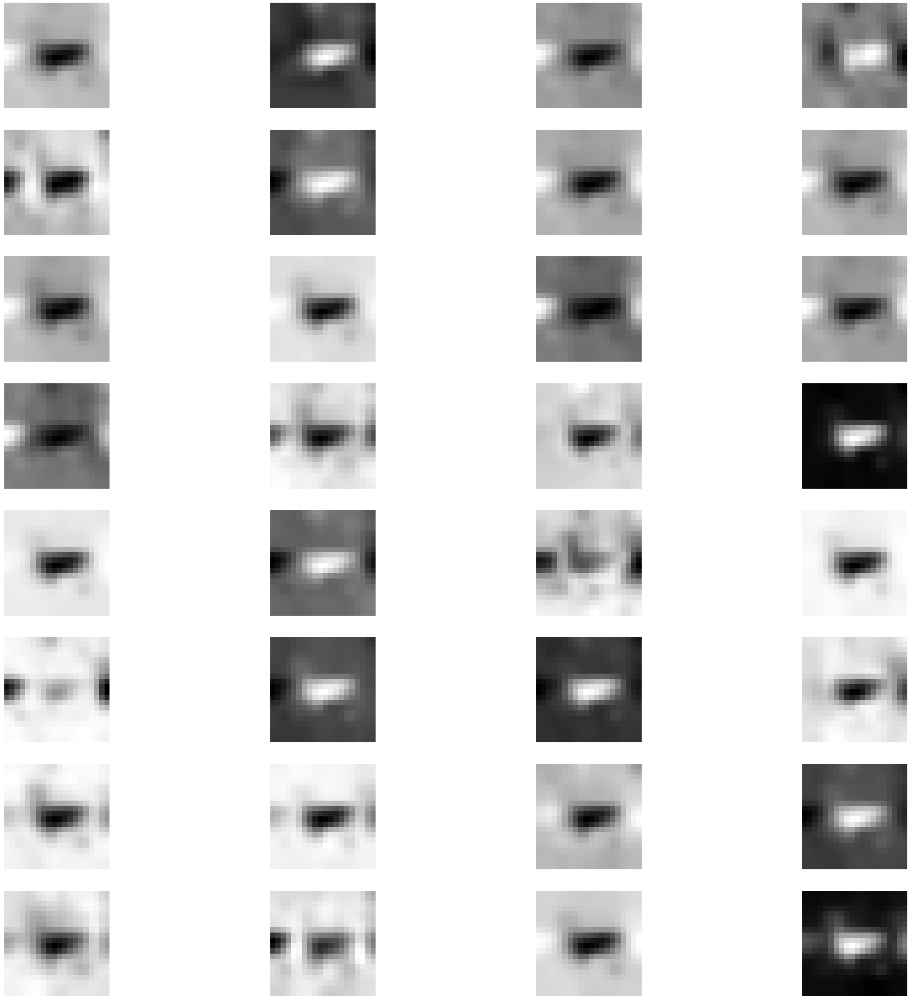

feature maps of conv layer number 32


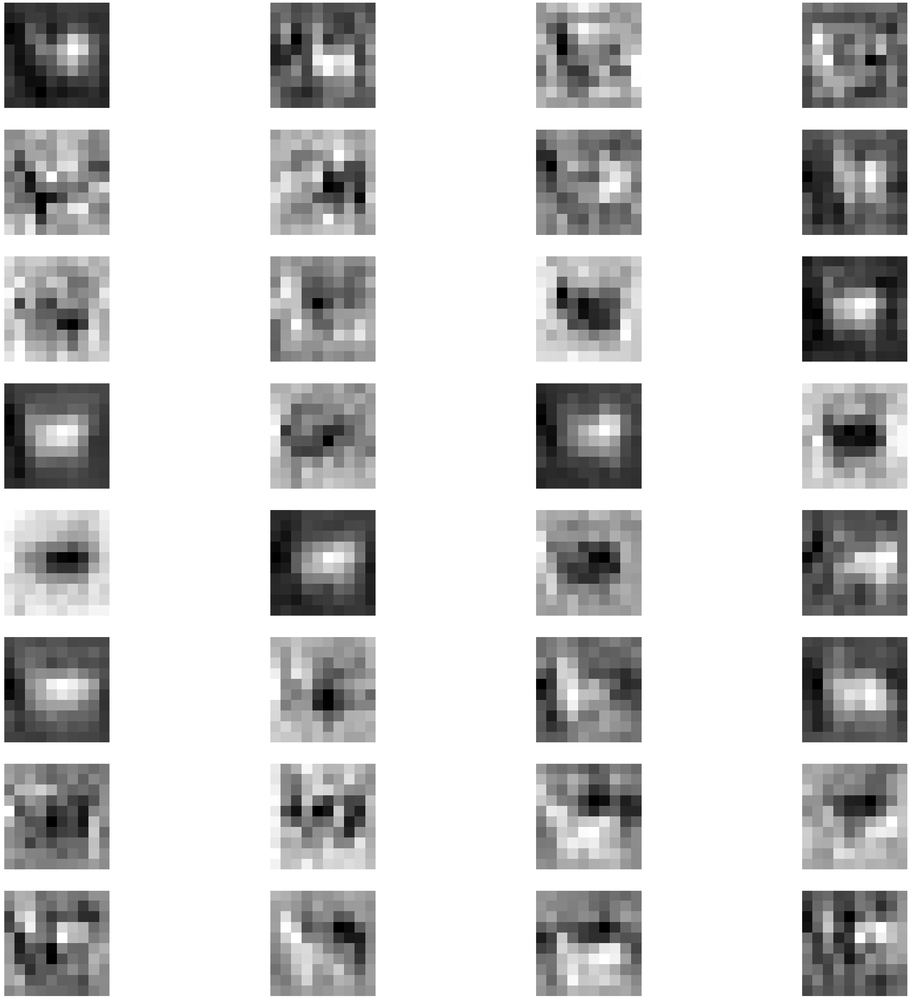

feature maps of conv layer number 33


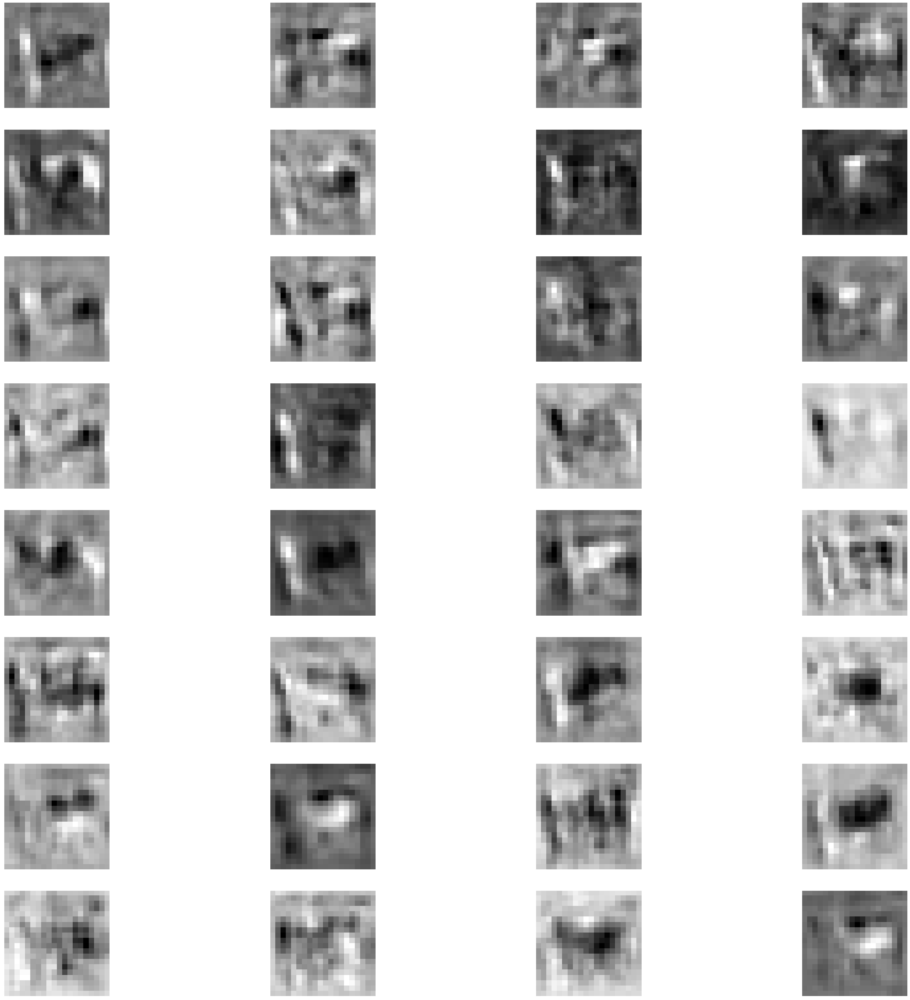

feature maps of conv layer number 34


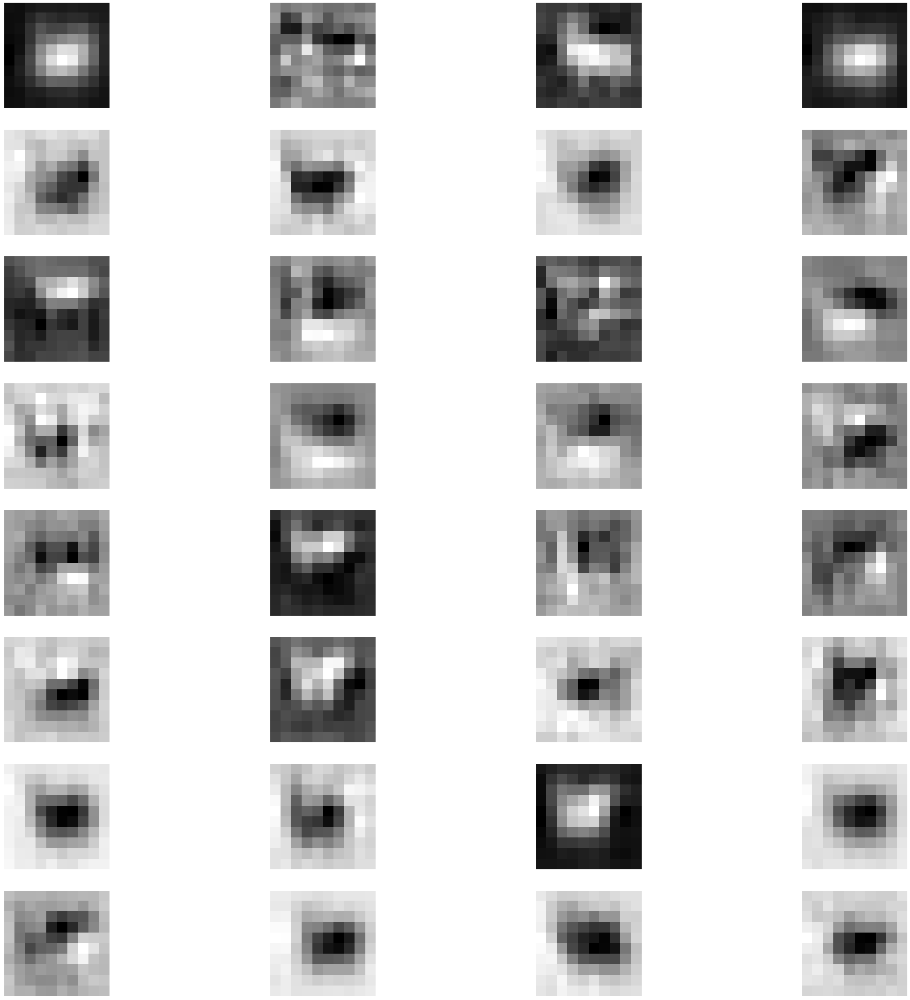

feature maps of conv layer number 35


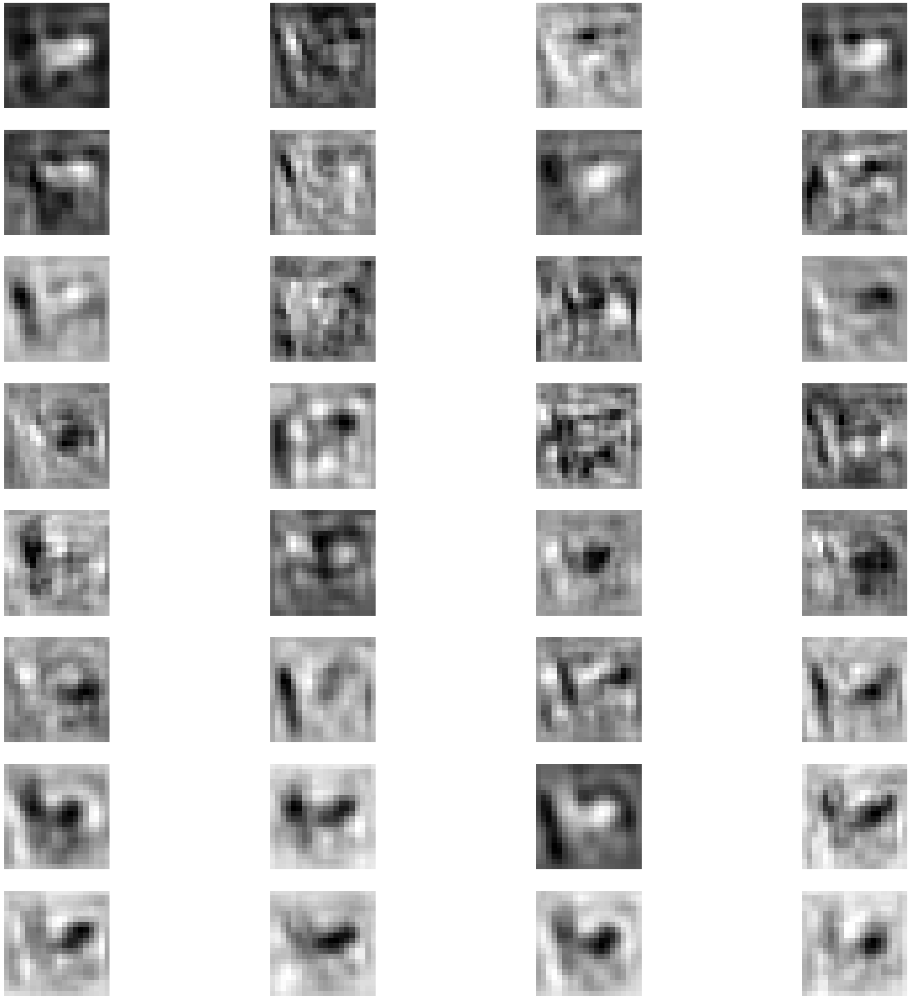

feature maps of conv layer number 36


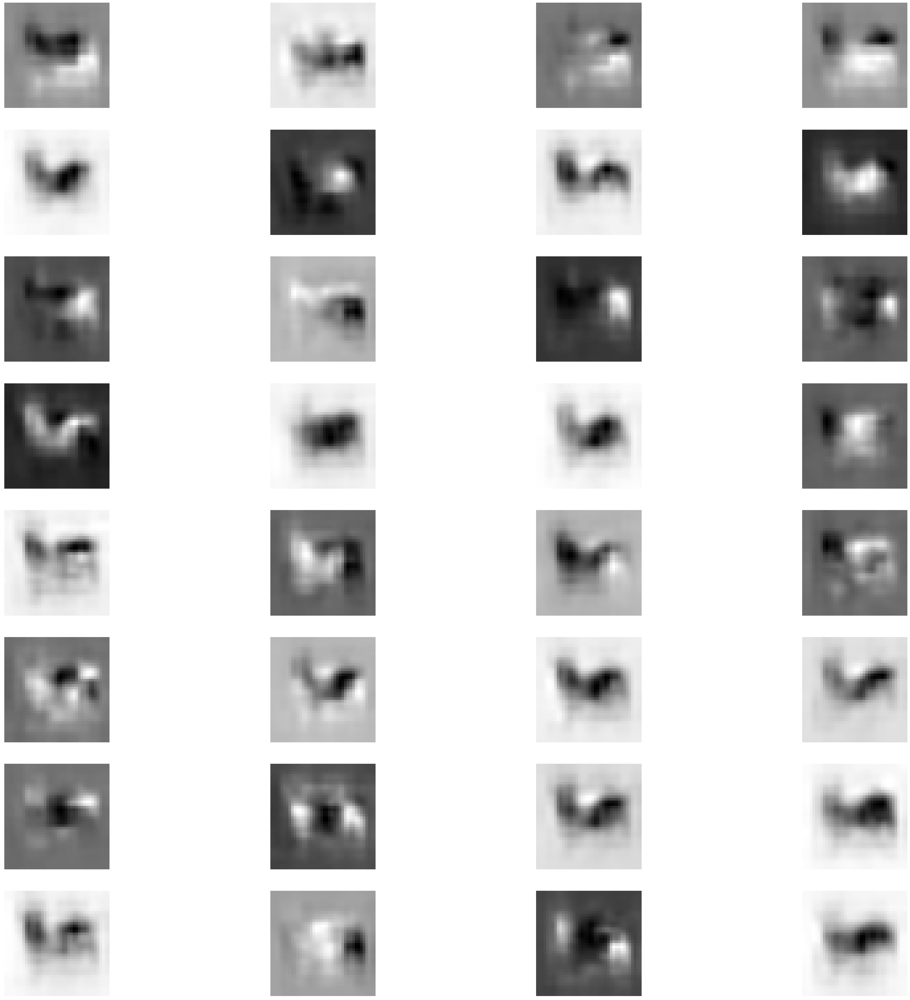

feature maps of conv layer number 37


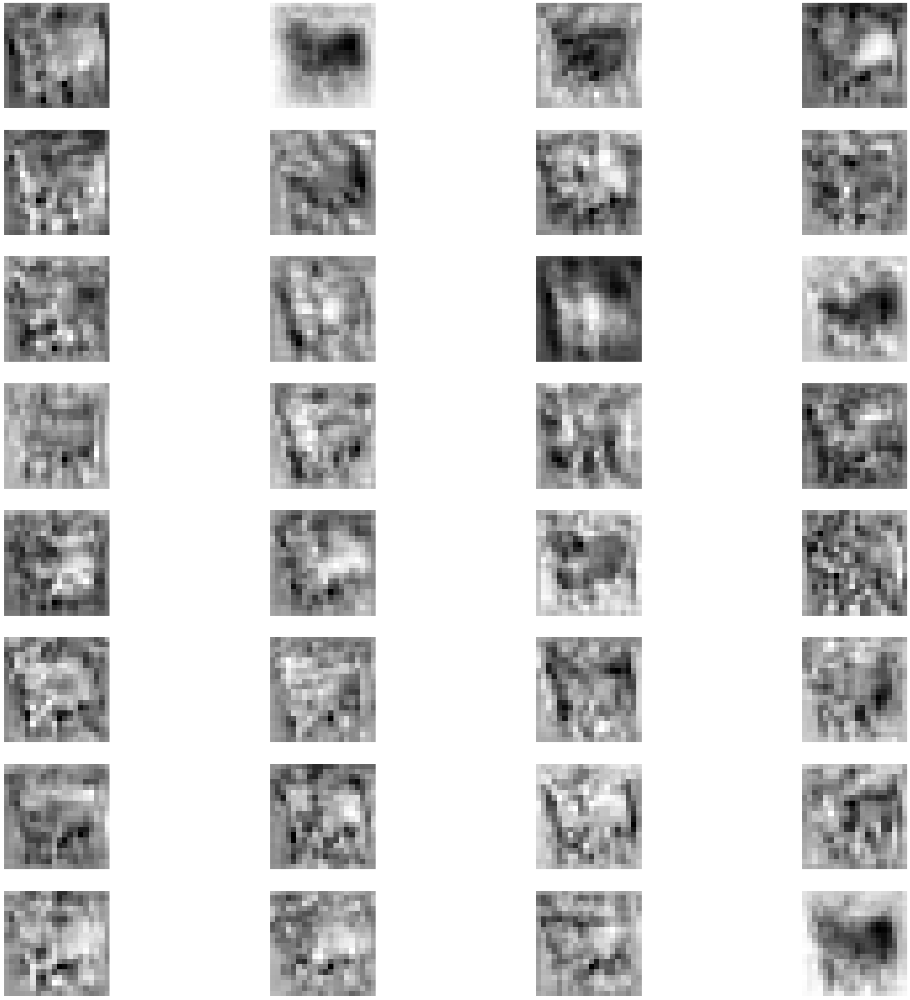

feature maps of conv layer number 38


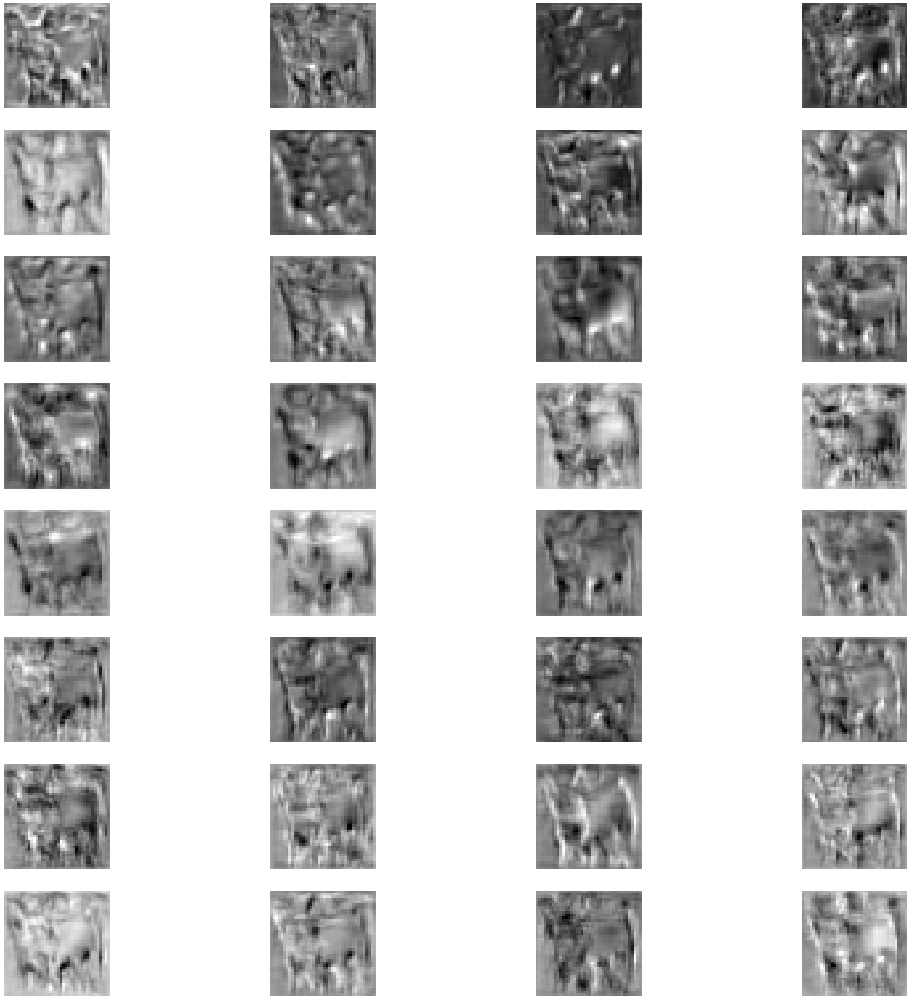

feature maps of conv layer number 39


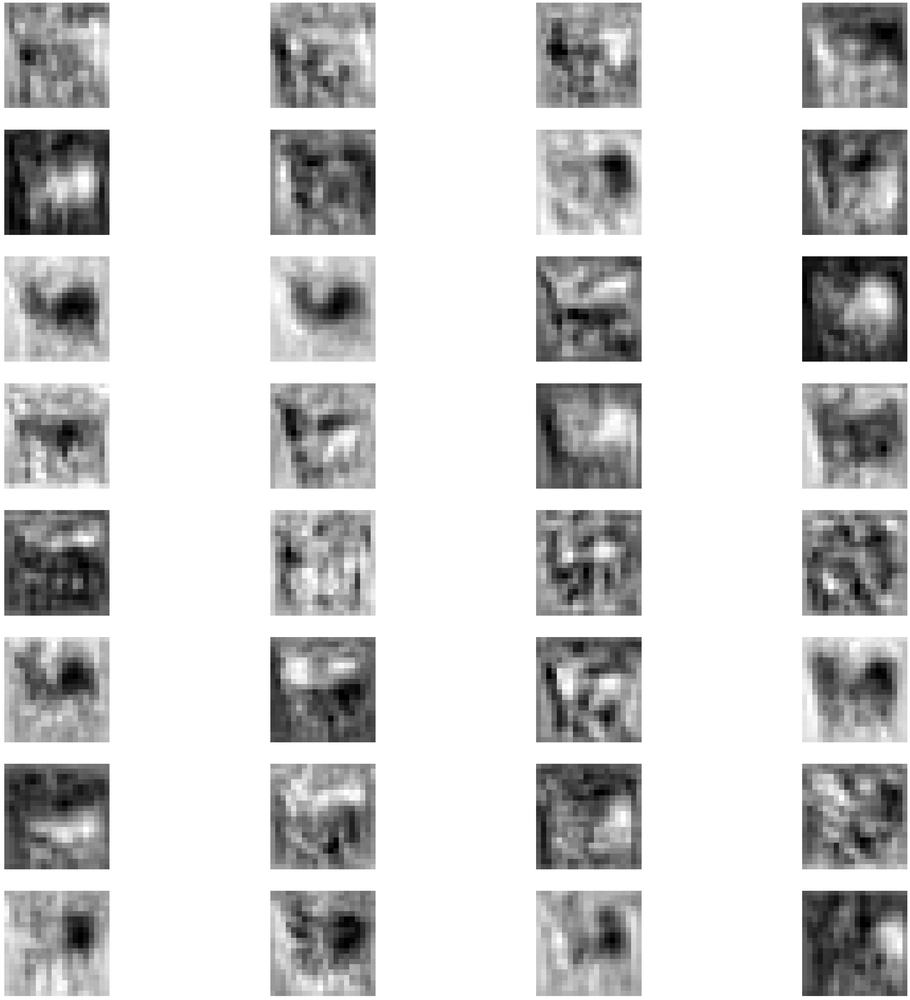

feature maps of conv layer number 40


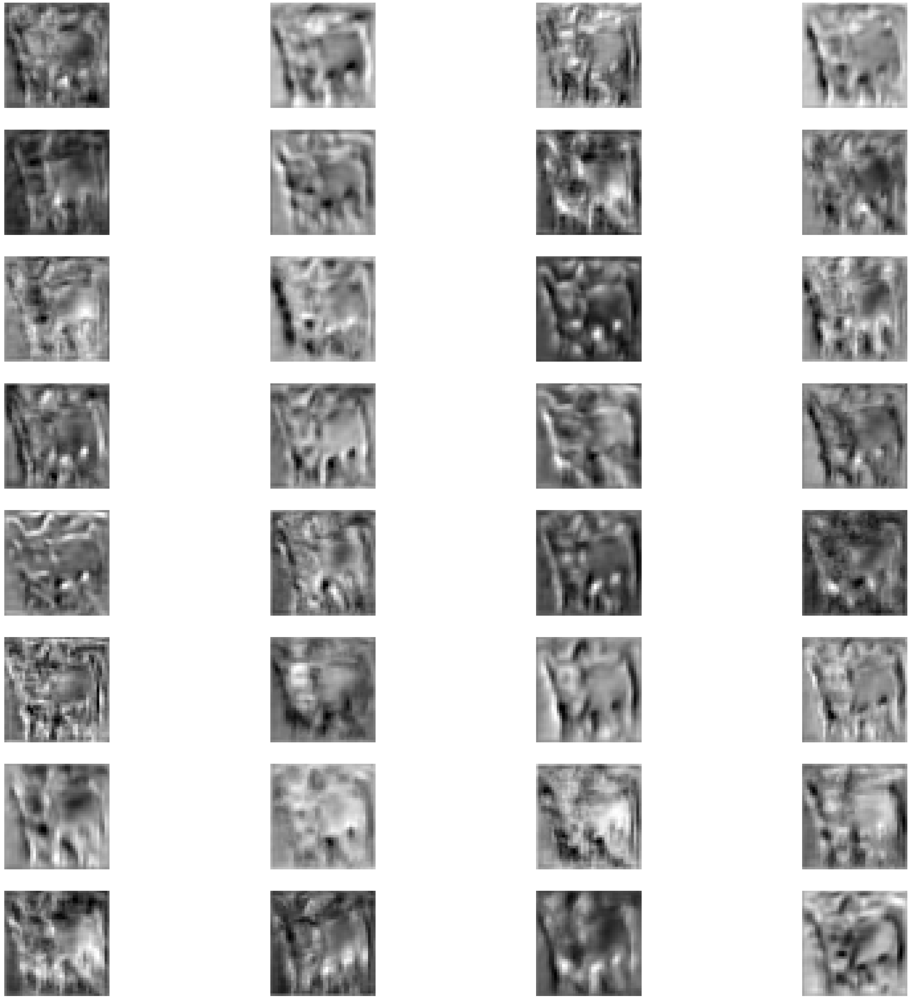

feature maps of conv layer number 41


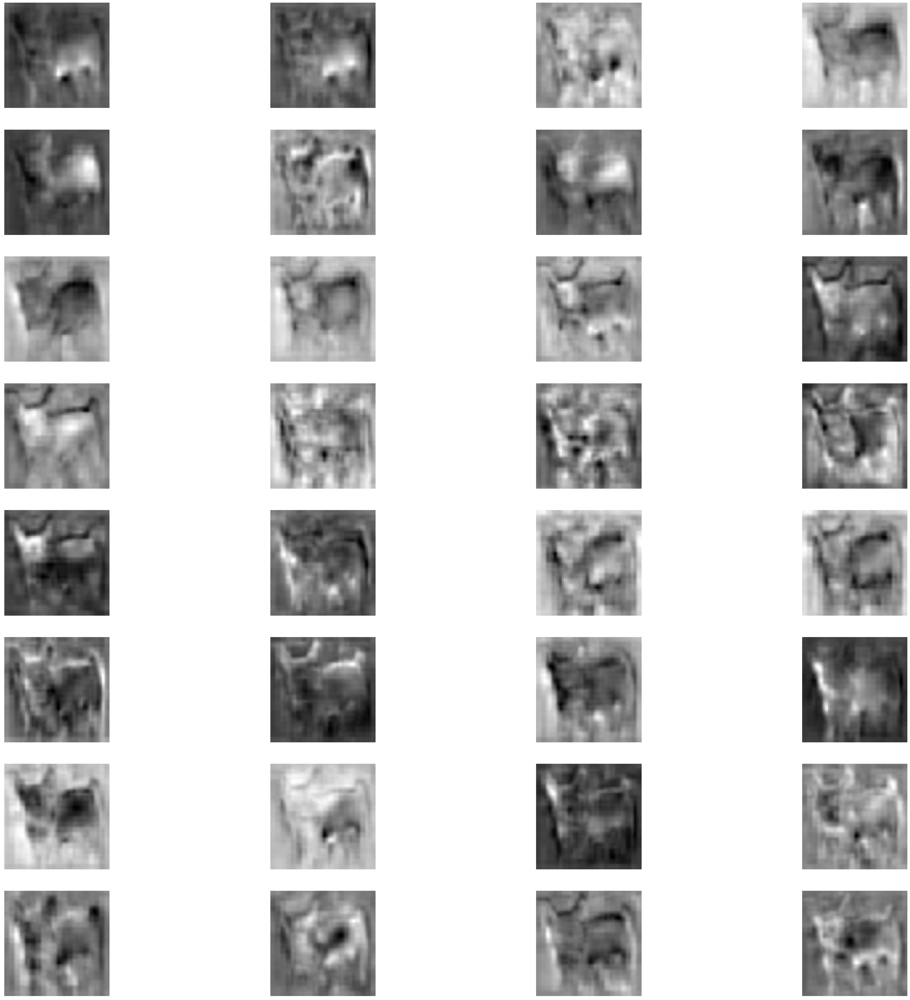

feature maps of conv layer number 42


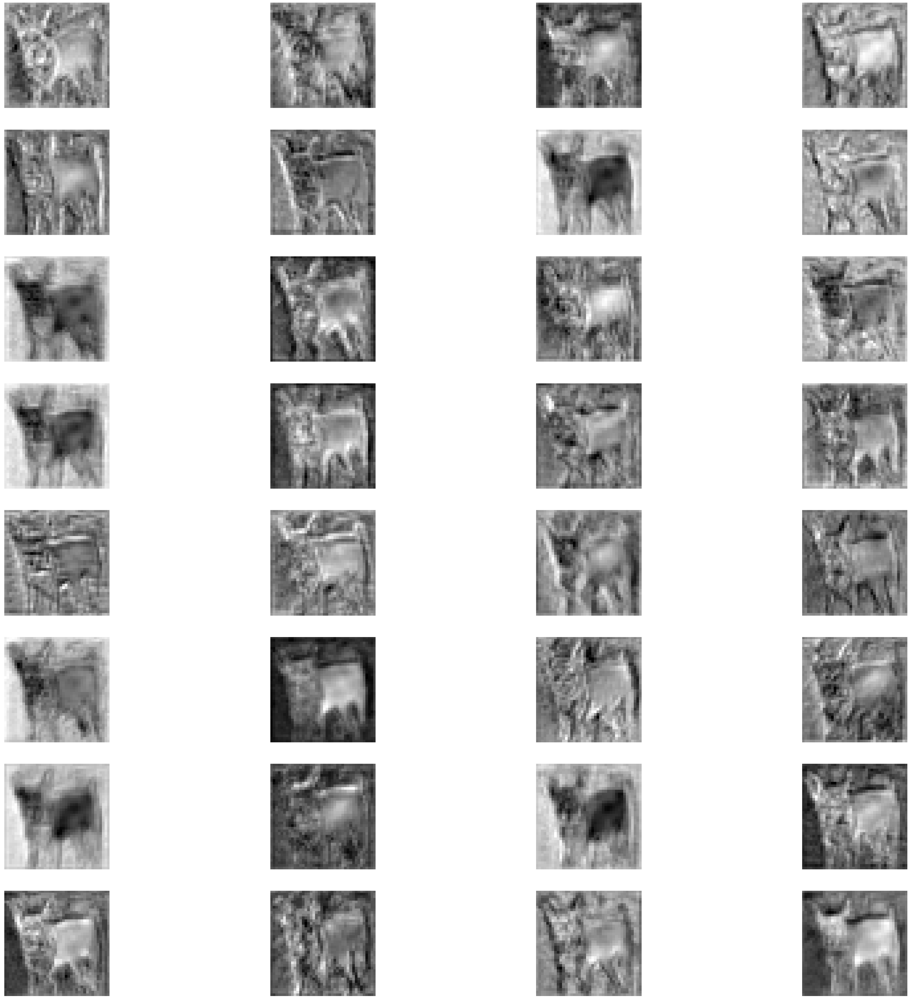

feature maps of conv layer number 43


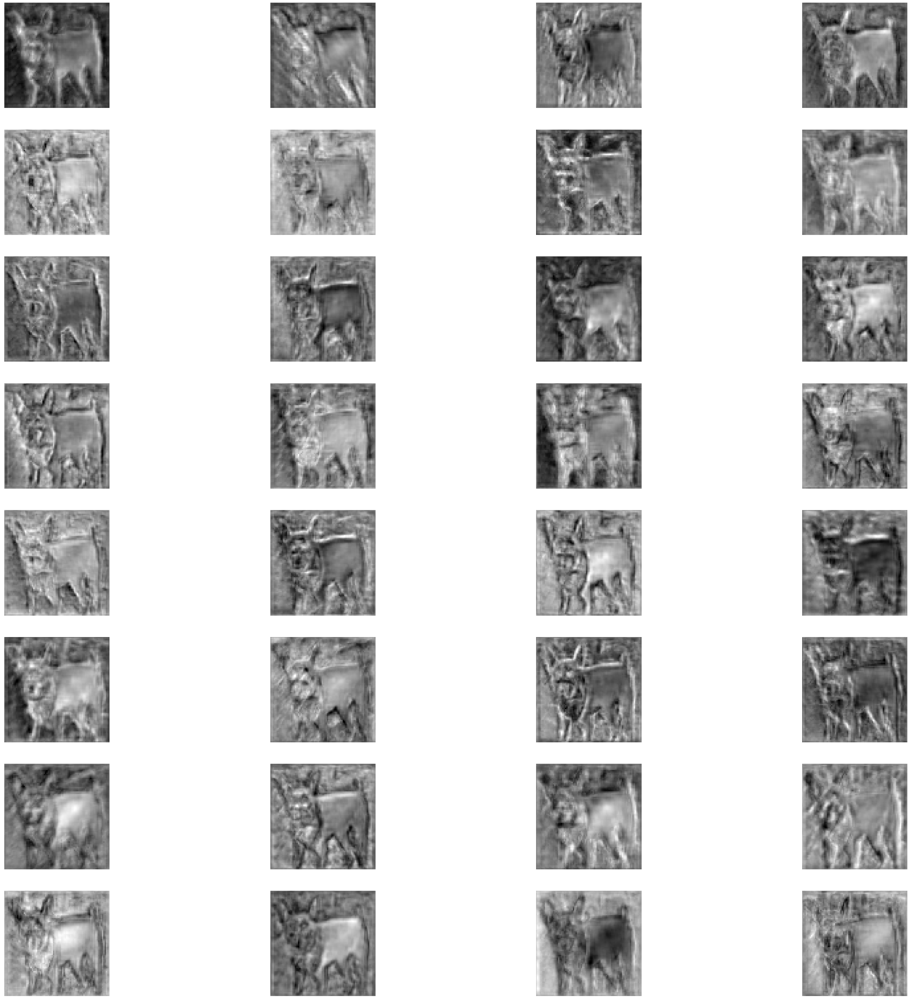

feature maps of conv layer number 44


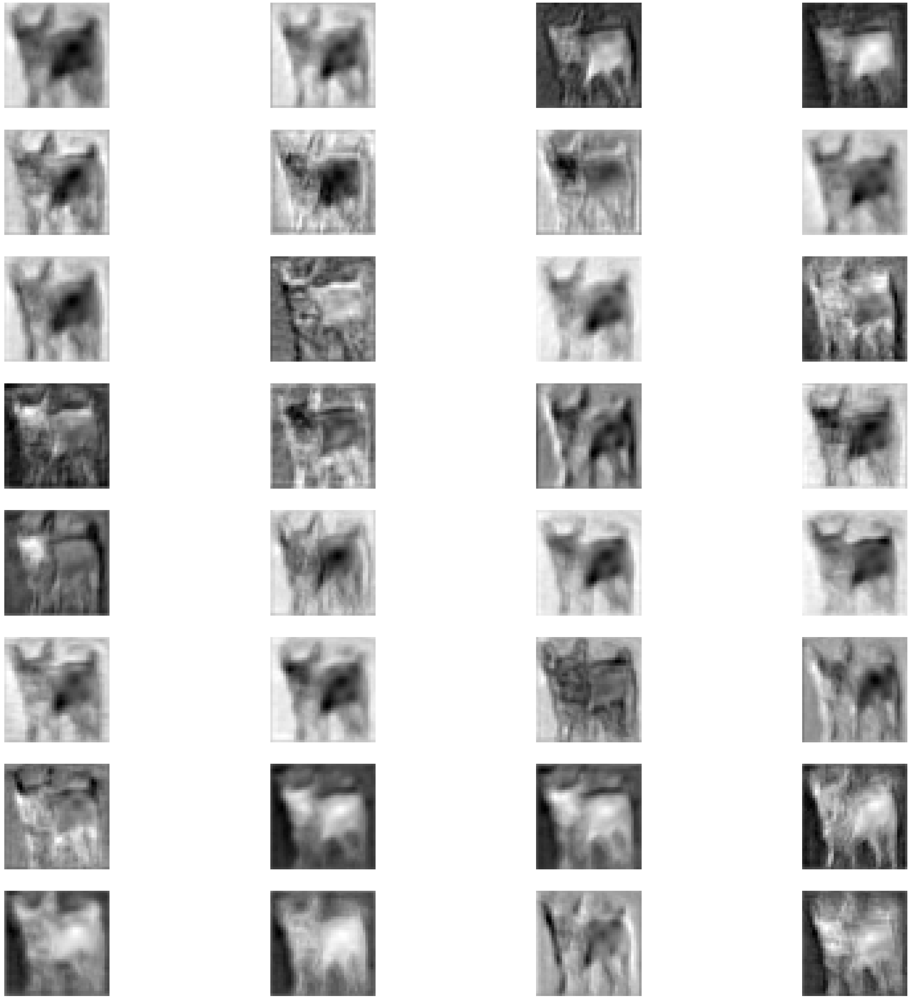

feature maps of conv layer number 45


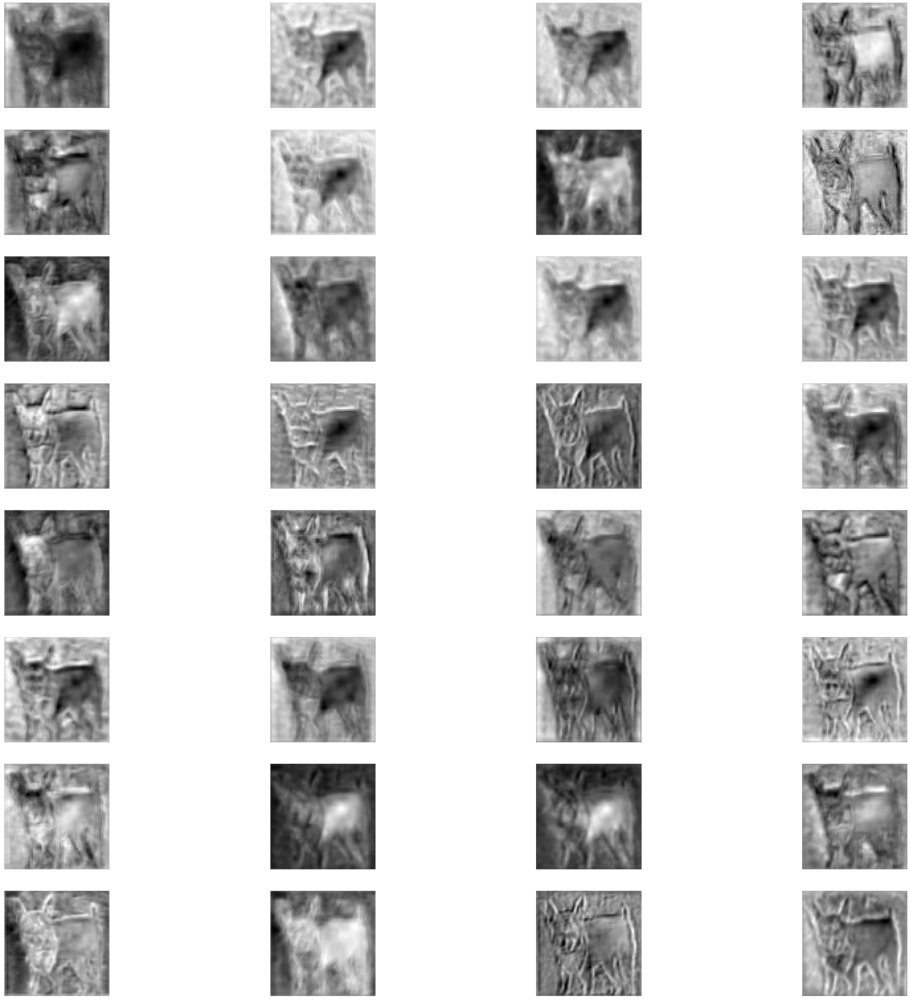

feature maps of conv layer number 46


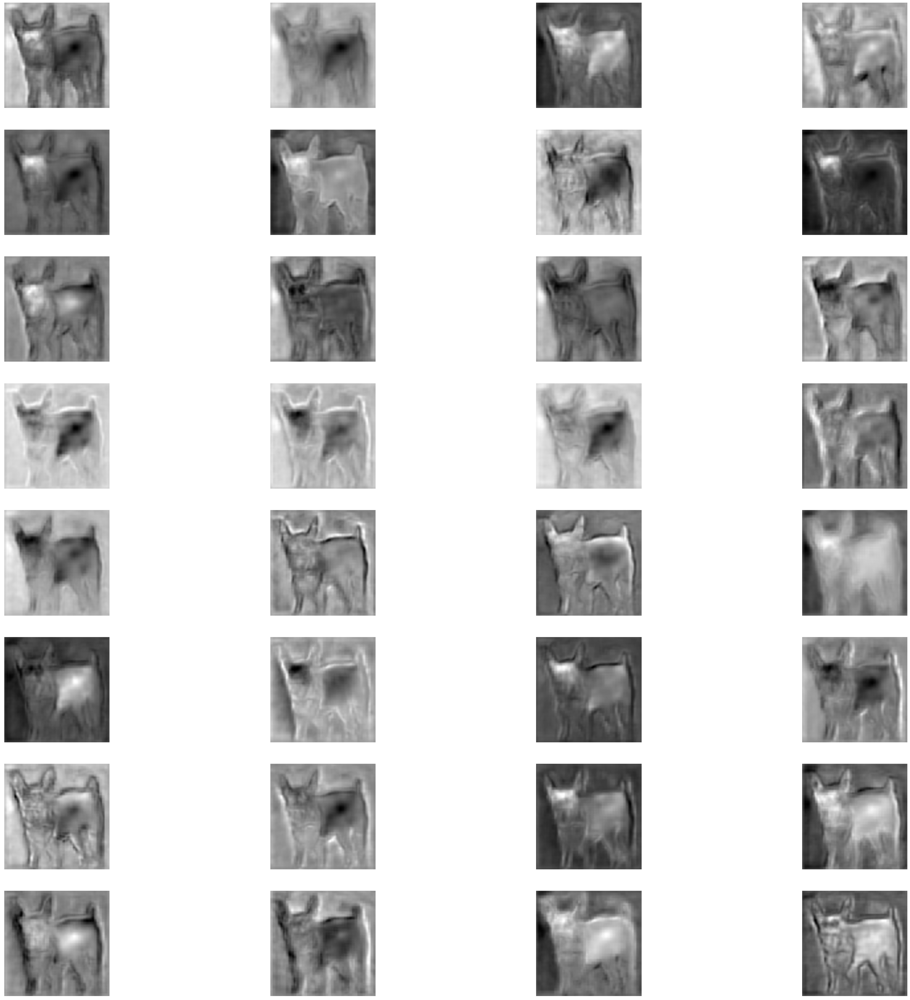

feature maps of conv layer number 47


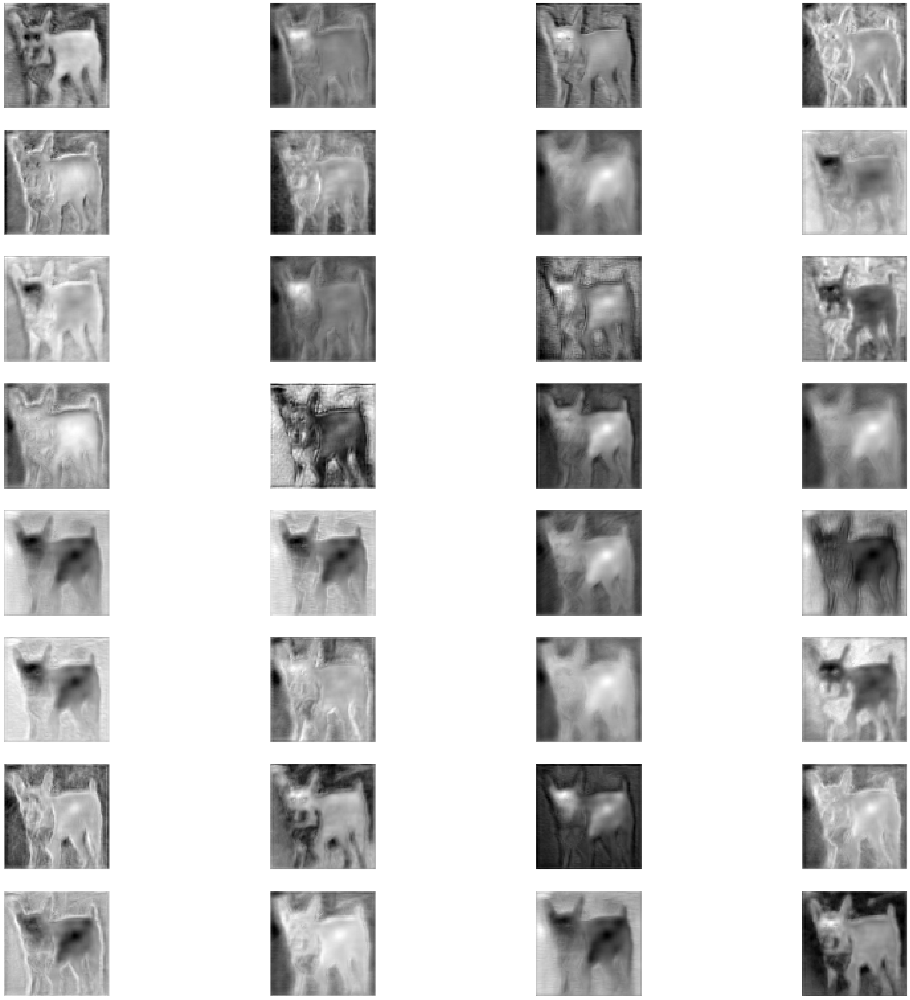

feature maps of conv layer number 48


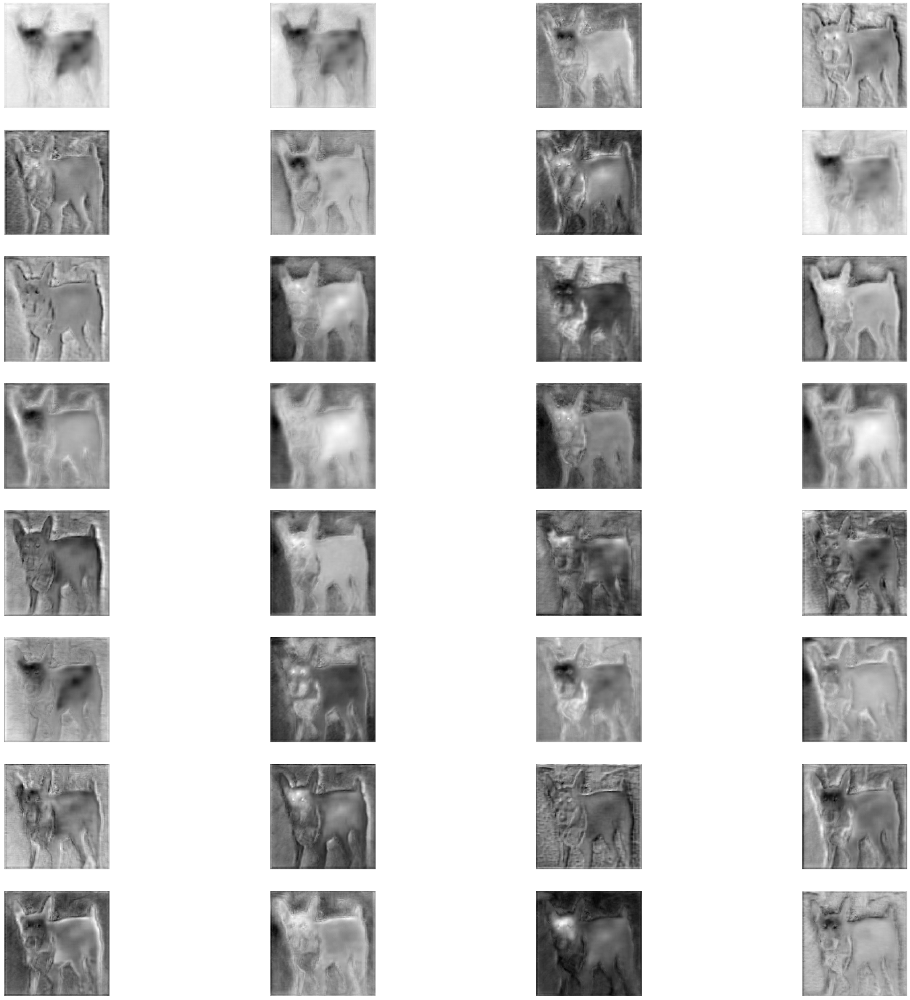

feature maps of conv layer number 49


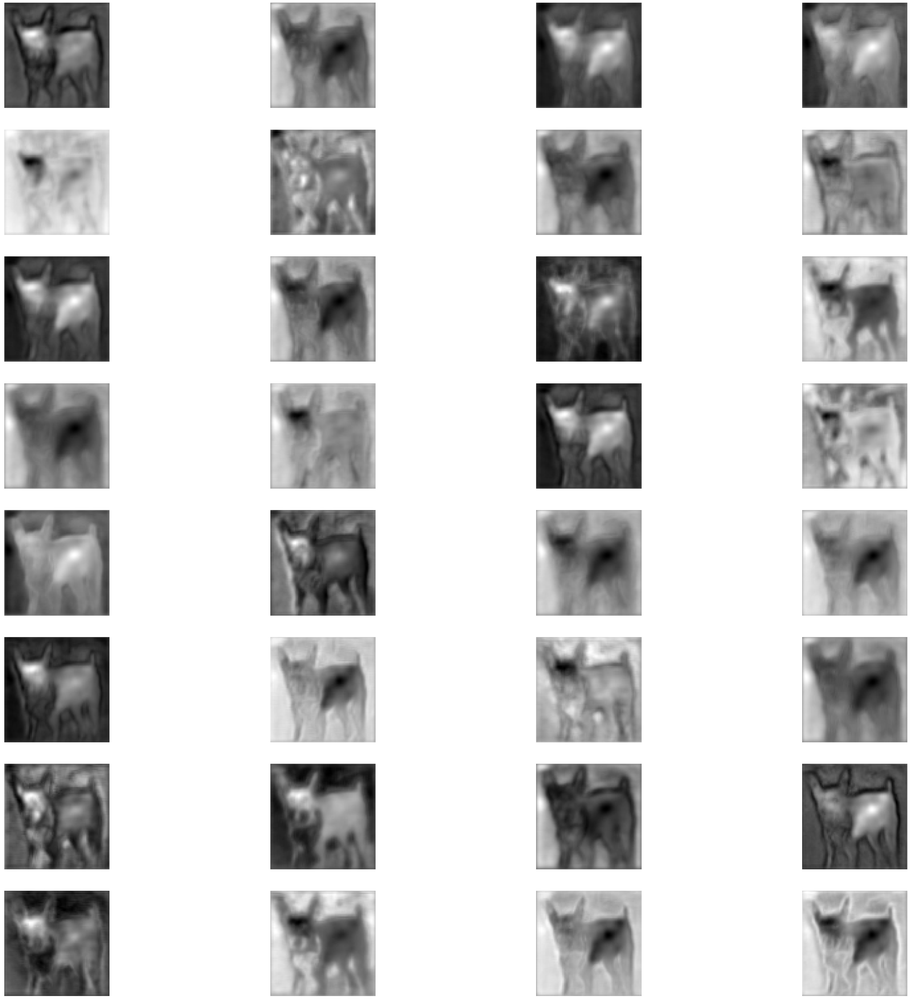

feature maps of conv layer number 50


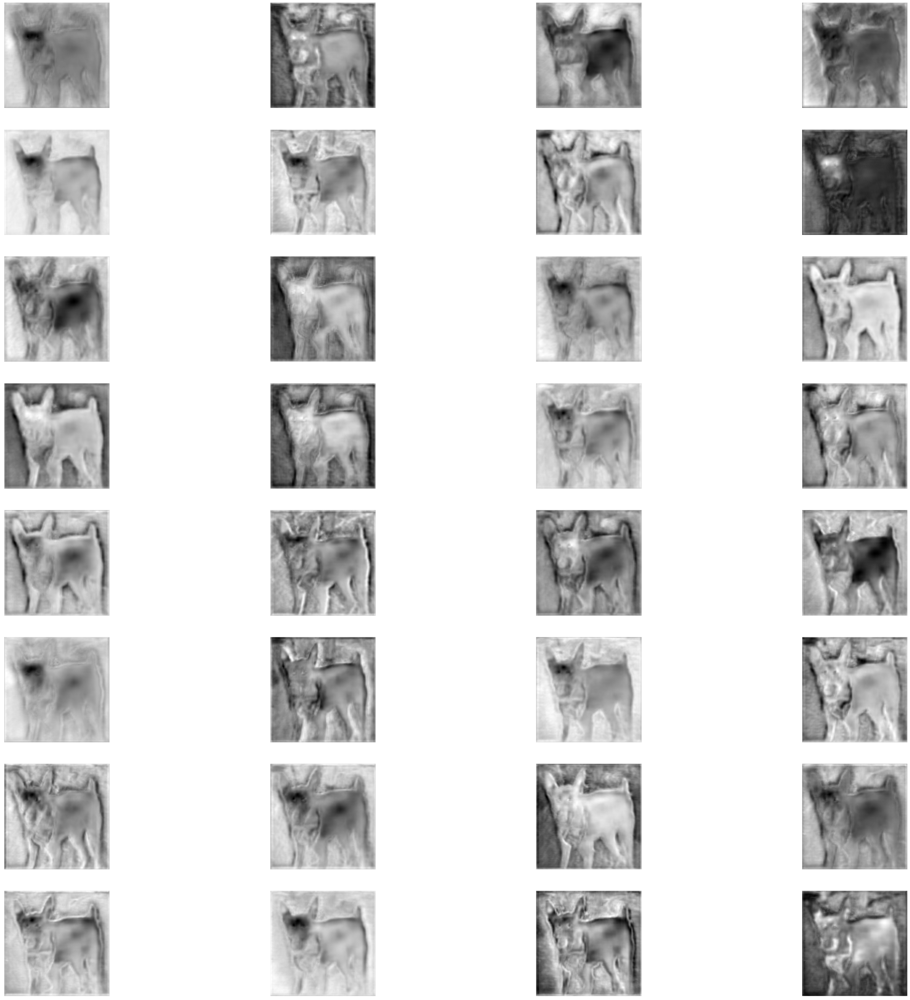

In [30]:
square = 8
j = 0
for fmap in feature_maps:
    # plot all 32 maps in an 8x4 squares
    ix = 1
    plt.figure(figsize=(50, 50), dpi=80)
    for _ in range(8):
        for i in range(4):
          # specify subplot and turn of axis
          ax = plt.subplot(8, 4, ix)
          ax.set_xticks([])
          ax.set_yticks([])
          # plot filter channel in grayscale
          plt.imshow(fmap[0, :, :, ix-1], cmap='gray')
          ix += 1
    # show the figure
    j += 1
    print(f'feature maps of conv layer number {j}')
    plt.show()
    # As the last layer (number 51) has 3 filters we should plot it in another way
    if j == 50:
      break

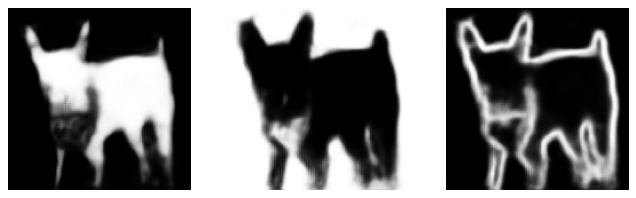

In [46]:
# Visualize last convolution layer, this layer has 3 filters.
f = feature_maps[50]
plt.figure(figsize=(10, 10), dpi=80)  
for i in range(3):
  ax = plt.subplot(1, 3, i+1)
  ax.set_xticks([])
  plt.grid(False)
  plt.axis('off')
  ax.set_yticks([])
  # plot filter channel in grayscale
  plt.imshow(f[0, :, :, i], cmap='gray')

plt.show()